# Сверточные сети (CNN)


В этом ноутбуке мы будем решать задачу классификации и сравним 2 подхода: полносвязная сеть (fully-connected NN или MLP) и сверточная сеть (CNN). Также рассмотрим более продвинутые модели классификации.

Чтобы все корректно отработало, этот ноутбук, как и в прошлый раз, нужно запускать в той среде, где есть графический процессор GPU. Бесплатно воспользоваться GPU можно в <a href="https://colab.research.google.com/?hl=ru" target="_blank">Google Colab</a> и [Kaggle](https://www.kaggle.com/). Однако учтите, что на данный момент доступ к GPU ограничен работой в несколько часов в сутки. Для того, чтобы подключиться к GPU в Colab, зайдите в меню `Среда выполнения`, выберите опцию `Сменить среду выполнения`. В списке аппаратных ускорителей выберите GPU.

In [3]:
# Установите библиотеки, если необходимо
!pip install -q opencv-python
!pip install -q torchinfo

In [4]:
import os
import glob
import time
import warnings
from collections import defaultdict
from typing import Callable, Dict, List, Sequence, Tuple, Union

import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.auto import tqdm

import torch
from torch import nn, optim
import torch.nn.functional as F
import torchvision
from torchvision import transforms
from torchinfo import summary
from torchvision.transforms.functional import to_tensor, rgb_to_grayscale
from torch.utils.data import DataLoader
import torchvision.models as models

from sklearn.model_selection import train_test_split

from IPython.display import clear_output

sns.set(font_scale=1, style="darkgrid", palette="Set2")
warnings.simplefilter("ignore")

device = f"cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


### 1. Convolution (свёртка)

#### 1.1. Описание свертки

**Изображение**

Цветная картинка — это матрица пикселей размером $H \times W$, где:
- $H$ — высота в пикселях,
- $W$ — ширина в пикселях.

Пиксель обычно представляется в RGB формате: массив интенсивностей для красного, зелёного и синего цветов. Каждая интенсивность — это число от 0 до 1, но чаще её кодируют числом от 0 до 255 (1 байт).

Цветная картинка представлена тензором размера $(H, W, 3)$, состоящим из чисел типа `uint8`.


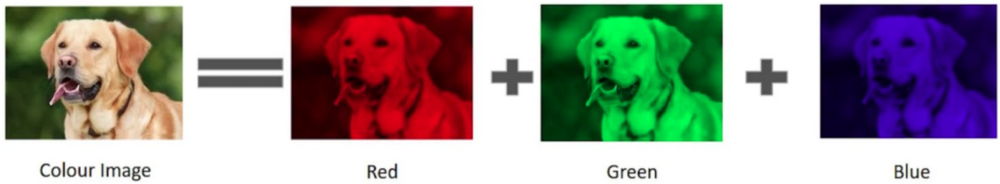

В PyTorch для удобства изображения представляют в виде тензоров размера $(C, H, W)$, где $C$ — количество каналов. Для цветных изображений обычно $C = 3$. Это необходимо, потому что в PyTorch часто работают с батчами изображений, и представление тензора как $(C, H, W)$ удобно для обработки: каждый канал (например, красный, зелёный, синий) рассматривается как отдельный слой, что позволяет эффективнее организовывать вычисления и работу с большими данными.



**Свёртка в PyTorch**

В PyTorch свёртка реализуется через слой `nn.Conv2d`.

> Основные гиперпараметры:
> - **`in_channels`** (int): количество каналов во входном изображении.
> - **`out_channels`** (int): количество каналов после применения свёртки (количество ядер (фильтров), которые будут применяться).
> - **`kernel_size`** (int, tuple): размер сверточного ядра.
> - **`stride`** (int, tuple): шаг, с которым будет применяться свёртка. Значение по умолчанию — `1`.
> - **`padding`** (int, tuple): добавление дополнительных пикселей по краям изображения. Значение по умолчанию — `0`.
> - **`padding_mode`** (string, optional): принцип заполнения краёв. Значение по умолчанию — `'zeros'`.

**Пример использования**

Предположим, у нас есть изображение размером `1x5x5`, где:
- `1` — количество каналов (например, это может быть один канал серого изображения),
- `5` — высота изображения (5 пикселей),
- `5` — ширина изображения (5 пикселей).

Применим свёртку с параметрами:

```python
nn.Conv2d(in_channels=1, out_channels=1, kernel_size=3, stride=2, padding=1, padding_mode='zeros')
```

Свёртка с такими параметрами работает следующим образом.
* Сначала паддинг (`padding=1`) добавляет слой нулевых пикселей (`padding_mode='zeros'`) по краям изображения, что позволяет фильтру захватывать информацию с краёв, не уменьшая размеры изображения слишком сильно.
* Далее фильтр размером 3x3 (`kernel_size=3`) применяется к блокам 3x3 пикселей, начиная с верхнего левого угла. На каждом шаге фильтр *поэлементно* умножает пиксели на свои веса и суммирует результаты. На очередном шаге фильтр сдвигается на два пикселя (при `stride=2`), что уменьшает размер выходного изображения.


![](padding_strides.gif)

В общем случае берём `out_channels` фильтров размера `in_channels x kernel_size x kernel_size`. В итоге мы получаем `out_channels` выходных тензоров.


**Интуиция**

В полносвязных слоях (`Linear`) каждый нейрон текущего слоя соединён с каждым нейроном предыдущего слоя. В случае свёртки нейрон соединён только с ограниченной областью выхода предыдущего слоя. Эта область называется *рецептивным полем* (receptive field) нейрона.



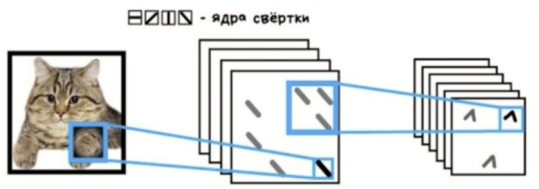

Такой подход необходим из-за большой размерности входных данных. Например, если размер входного изображения $3 \times 224 \times 224$, то *каждый нейрон* в слое с полной связностью будет иметь $3 \times 224 \times 224 = 150\:528$ параметров, что крайне много. Чтобы уменьшить количество параметров и иметь возможность добавлять нелинейности, архитектуры обычно используют несколько свёрточных слоёв.

&#x2753; **Вопрос** &#x2753;

> К изображению `(3, 224, 224)` применяют свертку `nn.Conv2d(in_channels=3, out_channels=64, kernel_size=5, stride=2, padding=2)`.
>
> * Какой будет размер выходного изображения?
> * Сколько у данного слоя обучаемых параметров?

*Проверяем себя.* Для ответа на вопрос будем использовать библиотеку `torchinfo`. Метод `summary` данной библиотеки позволяет визуализировать основные характеристики нейронной сети.

In [ ]:
model = nn.Sequential()
model.add_module(
    "conv", nn.Conv2d(in_channels=3, out_channels=64, kernel_size=5, stride=2, padding=2)
)

summary(model.to(device), (2, 3, 224, 224))

Layer (type:depth-idx)                   Output Shape              Param #
Sequential                               [2, 64, 112, 112]         --
├─Conv2d: 1-1                            [2, 64, 112, 112]         4,864
Total params: 4,864
Trainable params: 4,864
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 122.03
Input size (MB): 1.20
Forward/backward pass size (MB): 12.85
Params size (MB): 0.02
Estimated Total Size (MB): 14.07

> **Размер выхода**
>    - После добавления по $2$ пикселя с каждой стороны изображения (`padding=2`) изображение имеет размер $(228, 228)$.
>    - При `stride=2` ядро $5 \times 5$ проходит по изображению с шагом два. Количество шагов: $\frac{228 - 5}{2} + 1 = 112$, где $1$ отвечает за первое применение свертки, а дробь — за количество возможных сдвигов.
>    - Всего применяется $64$ ядра (`out_channels=64`).
>
> Итоговый размер выхода: $(64, 112, 112)$ — $64$ канала, высота и ширина по $112$ пикселей.
>
> **Количество обучаемых параметров**
> 1. Параметры свертки:
>    - Количество весов для одного фильтра: $3 \times 5 \times 5 = 75$ (`in_channels x kernel_size x kernel_size`).
>    - Количество фильтров: $64$ (`out_channels`).
>    - Итого весов: $75 \times 64 = 4800$.
>
> 2. Параметры смещения:
>    - Для каждого фильтра добавляется один параметр смещения.
>    - Итого смещений: $64$.
>
> Получаем общее количество параметров: $4800 + 64 = 4864$.


**Общий вид формул**

В общем случае размер выхода по каждой размерности можно вычислить по следующей формуле
$$\text{Output Size} = \left\lfloor \frac{\text{Input Size} - \text{Kernel Size} + 2 \times \text{Padding}}{\text{Stride}} \right\rfloor + 1,$$

а количество параметров при этом равно
$$\text{Parameters} = (\text{Kernel Size} \times \text{Kernel Size} \times \text{In Channels} + 1) \times \text{Out Channels},$$

где:
* $\text{Input Size}$ — размер входного изображения (ширина или высота),
* $\text{Kernel Size}$ — размер ядра свертки,
* $\text{In Channels}$ — число входных каналов,
* $\text{Out Channels}$ — число выходных каналов (количество фильтров),
* $\text{Padding}$ — количество добавленных пикселей по краям изображения,
* $\text{Stride}$ — шаг свертки (на сколько пикселей сдвигается фильтр),
* $+1$ — параметр смещения (bias) для каждого фильтра.


#### 1.2. Пример

Посмотрим на то, как применение свёртки с определёнными фильтрами влияет на изображение и как будет меняться картинка в зависимости от фильтра.

Скачаем изображения с помощью утилиты `wget`.

In [ ]:
!wget https://i01.fotocdn.net/s217/4ad56f83edb719b5/gallery_m/2956235713.jpg -O Lenna.jpg
!wget https://upload.wikimedia.org/wikipedia/commons/3/3f/Bikesgray.jpg

--2025-03-30 06:37:24--  https://i01.fotocdn.net/s217/4ad56f83edb719b5/gallery_m/2956235713.jpg
Resolving i01.fotocdn.net (i01.fotocdn.net)... 130.117.76.67
Connecting to i01.fotocdn.net (i01.fotocdn.net)|130.117.76.67|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 77949 (76K) [image/jpeg]
Saving to: ‘Lenna.jpg’

Lenna.jpg           100%[===================>]  76.12K   228KB/s    in 0.3s    

2025-03-30 06:37:25 (228 KB/s) - ‘Lenna.jpg’ saved [77949/77949]

--2025-03-30 06:37:25--  https://upload.wikimedia.org/wikipedia/commons/3/3f/Bikesgray.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 198.35.26.112, 2620:0:863:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|198.35.26.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 190950 (186K) [image/jpeg]
Saving to: ‘Bikesgray.jpg’

Bikesgray.jpg       100%[===================>] 186.47K  --.-KB/s    in 0.06s   

2025-03-30 06:37:26 (3.22 MB/s) - ‘Bikesgray.

Посмотрим на эти изображения

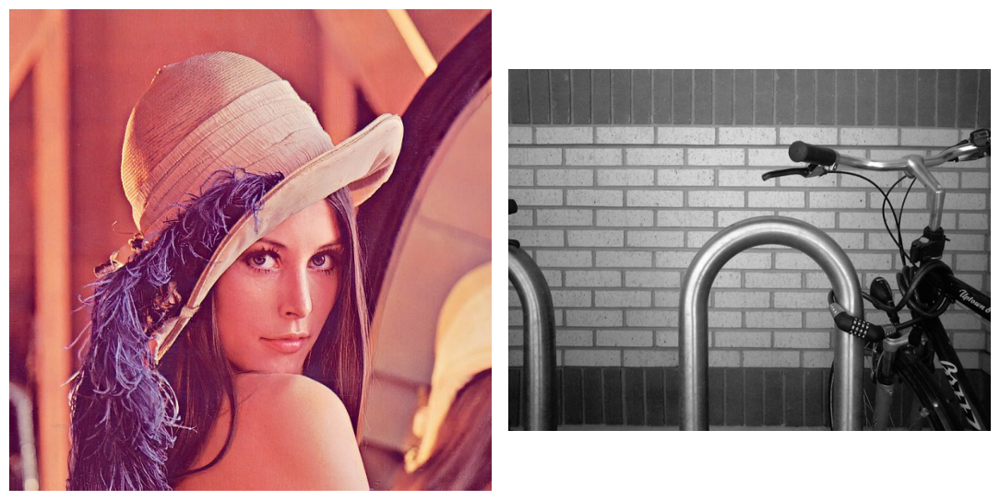

In [ ]:
imgs = [plt.imread("Lenna.jpg"), plt.imread("Bikesgray.jpg")]

fig, axs = plt.subplots(1, 2, figsize=(11, 6))
axs[0].imshow(imgs[0])
axs[0].axis("off")
axs[1].imshow(imgs[1], cmap="gray")
axs[1].axis("off")
plt.tight_layout()

> Изображение **Lenna** — известный тестовый образ в обработке изображений. Оно взято в ноябре 1972 из одного известного журнала (название не указываем из этических соображений) и изображает шведскую модель **Лену Сёдерберг**. В 1973 году исследователи из Университета Южной Калифорнии использовали его для тестирования алгоритмов сжатия. Благодаря сложной текстуре и деталям, оно стало стандартом в научных исследованиях.
>
> Использование этого изображения вызвало споры из-за происхождения, но сама Лена в итоге поддержала его применение в науке. Несмотря на этические дискуссии, изображение до сих пор используется, а в 2019 году журнал официально разрешил использовать его для научных целей. Lenna называют "Моной Лизой обработки изображений" и даже включили в коллекцию Музея современного искусства (MoMA).

Функция для инициализации весов слоя.

In [24]:
def init_conv(kernel: torch.Tensor, kernel_size: int = 3, channels: int = 3) -> nn.Conv2d:
    """
    Инициализирует Conv2d с заданным ядром свертки.

    Параметры:
        kernel (torch.Tensor): Ядро свертки, которое будет использоваться для инициализации Conv2d.
        kernel_size (int): Размер ядра свертки (по умолчанию 3).
        channels (int): Количество каналов входного изображения (по умолчанию 3).

    Возвращает:
        nn.Conv2d: Сверточный слой, инициализированный заданным ядром.
    """
    # Преобразуем ядро в формат (channels, 1, kernel_size, kernel_size)
    kernel = kernel.view(1, 1, kernel_size, kernel_size).repeat(channels, 1, 1, 1)

    # Создаем сверточный слой для независимой свертки по каналам
    conv = nn.Conv2d(
        in_channels=channels,
        out_channels=channels,
        kernel_size=kernel_size,
        groups=channels,
        bias=False,
    )

    # Инициализируем веса свертки заданным ядром и отключаем градиенты
    conv.weight.data = torch.FloatTensor(kernel)
    conv.weight.requires_grad = False
    return conv

Функция для свертки изображения с одним фильтром.

In [20]:
def convolution(
    kernel: torch.Tensor,
    img: torch.Tensor,
    transforms: transforms.Compose,
    kernel_size: int = 3,
    channels: int = 3,
) -> torch.Tensor:
    """
    Применяет свертку с заданным ядром к изображению.

    Параметры:
        kernel (torch.Tensor): Ядро свертки.
        img (torch.Tensor): Входное изображение.
        transforms (transforms.Compose): Методы предобработки изображения.
        kernel_size (int): Размер ядра свертки (по умолчанию 3).
        channels (int): Количество каналов изображения (по умолчанию 3).

    Возвращает:
        torch.Tensor: Результат свертки, преобразованный в изображение с пикселями от 0 до 255.
    """
    # Предобработка изображению
    img_tensor = transforms(img)
    # Добавляем батч-размерность
    img_tensor = img_tensor.unsqueeze(0)

    # Инициализируем сверточный слой
    conv = init_conv(kernel, kernel_size=kernel_size, channels=channels)
    # Применяем свертку
    res = conv(img_tensor)

    # Убираем единичные размерности
    res = res.detach().squeeze()
    # Обрезаем значения до диапазона [0, 1]
    res = (torch.clip(res, 0, 1) * 255).int()

    return res

**Гауссовский фильтр**

Попробуем применить разные фильтры, чтобы продемонстрировать работу свертки. Начнем с гауссовского фильтра, который определяется как *плотность гауссовского распределения* в двухмерном случае, нормализованной так, чтобы сумма коэффициентов в фильтре была равна $1$.


$$G_{2D}(x, y, \sigma) = \frac{1}{2 \pi \sigma^2} \exp\left({-\frac{x^2 + y^2}{2 \sigma^2}}\right)$$

In [ ]:
def get_gaussian_kernel(kernel_size: int = 15, sigma: float = 3) -> torch.Tensor:
    """
    Вычисляет гауссовское ядро для свертки.

    Параметры:
        kernel_size (int): Размер ядра (по умолчанию 15).
        sigma (float): Стандартное отклонение гауссовского распределения (по умолчанию 3).

    Возвращает:
        torch.Tensor: Нормализованное гауссовское ядро.
    """
    # Создаем сетку координат x, y, размер shape=(kernel_size, kernel_size, 2)
    x_cord = torch.arange(kernel_size)
    x_grid = x_cord.repeat(kernel_size).view(kernel_size, kernel_size)
    y_grid = x_grid.t()
    xy_grid = torch.stack([x_grid, y_grid], dim=-1)

    # Вычисляем среднее значение для центра ядра
    mean = (kernel_size - 1) / 2.0
    variance = sigma**2.0

    # Вычисляем гауссовское ядро
    gaussian_kernel = (1.0 / (2.0 * np.pi * variance)) * torch.exp(
        -torch.sum((xy_grid - mean) ** 2.0, dim=-1) / (2 * variance)
    )

    # Нормализуем ядро, чтобы сумма значений равнялась 1
    return gaussian_kernel / torch.sum(gaussian_kernel)

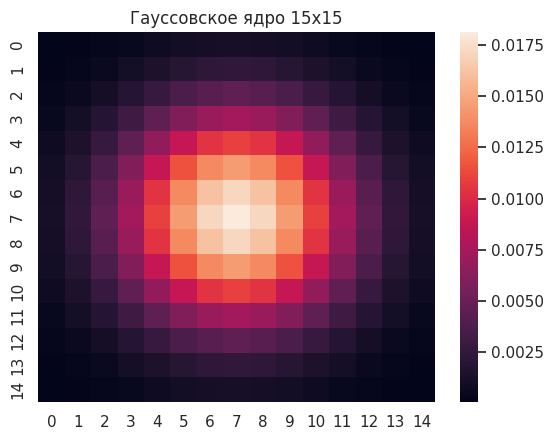

In [ ]:
kernel_size = 15  # Размер ядра
gaussian_kernel = get_gaussian_kernel(kernel_size)

sns.heatmap(gaussian_kernel)
plt.title("Гауссовское ядро 15x15");

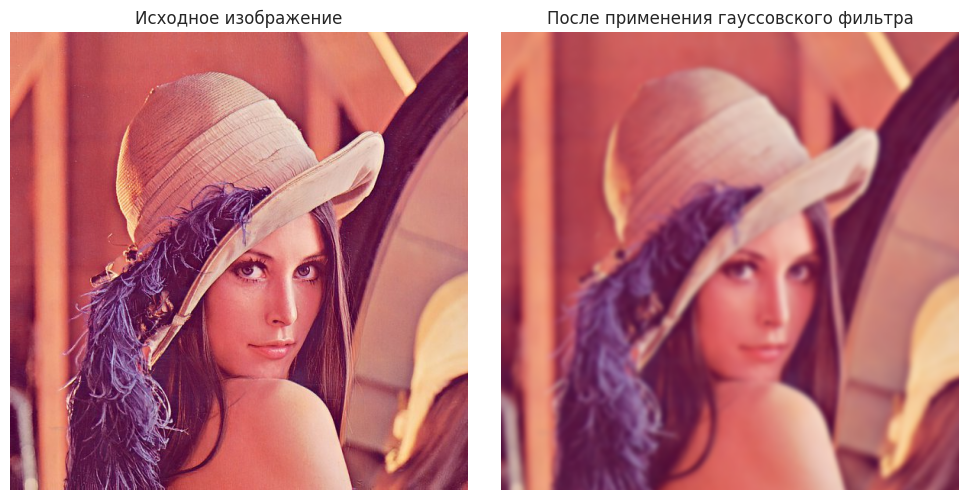

In [ ]:
res = convolution(gaussian_kernel, imgs[0], transforms.ToTensor(), kernel_size=kernel_size)

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(imgs[0])
axs[0].set_title("Исходное изображение")
axs[0].axis("off")
axs[1].imshow(res.permute(1, 2, 0))
axs[1].set_title("После применения гауссовского фильтра")
axs[1].axis("off")
plt.tight_layout()

Видим, что картинка размылась. Не зря так часто мы слышим выражение "Gaussian Blur".

**Оператор Собеля (выделение границ)**

Рассмотрим [оператор Собеля](https://ru.wikipedia.org/wiki/%D0%9E%D0%BF%D0%B5%D1%80%D0%B0%D1%82%D0%BE%D1%80_%D0%A1%D0%BE%D0%B1%D0%B5%D0%BB%D1%8F). Он вычисляет градиент яркости изображения в каждой точке. Так находится направление наибольшего увеличения яркости и величина её изменения в этом направлении. Результат показывает, насколько «резко» или «плавно» меняется яркость изображения в каждой точке, а значит, вероятность нахождения точки на грани, а также ориентацию границы.

* Матрица Собеля для градиента по горизонтали
$G_x = \begin{pmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{pmatrix}$

* Матрица Собеля для градиента по вертикали
$G_y = \begin{pmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1
\end{pmatrix}$

Эти матрицы применяются к изображению с помощью операции свертки, чтобы выделить границы объектов на изображении.

In [ ]:
kernel_size = 3  # Размер ядра
sobel_x = torch.FloatTensor([[[[1, 0, -1], [2, 0, -2], [1, 0, -1]]]])
sobel_y = torch.FloatTensor([[[[1, 2, 1], [0, 0, 0], [-1, -2, -1]]]])

Numpy-картинку нужно привести к torch-тензору. Кроме того, для визуализации нам нужно отобразить картинку в черно-белом цвете. Это можно сделать с помощью модуля `transforms`.

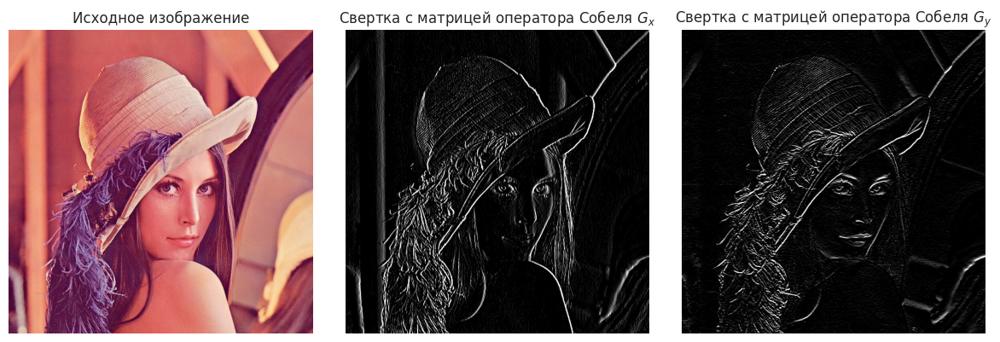

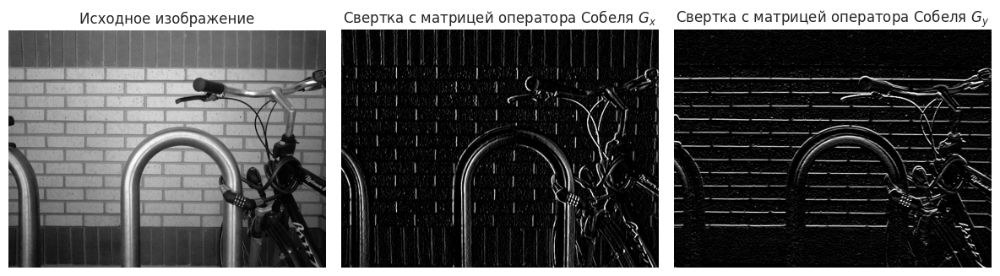

In [ ]:
transform_bw = transforms.Compose(
    [
        transforms.ToTensor(),  # Переводим массив в торч-тензор
        transforms.Grayscale(),  # Делаем изображение черно-белым
    ]
)

res_images = []
for i, img in enumerate(imgs):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(12, 4), sharey=True, sharex=False)

    axs[0].imshow(img, cmap="gray" if i == 1 else None)
    axs[0].set_title("Исходное изображение")
    axs[0].axis("off")
    res_images.append([])

    for j, kernel in enumerate([sobel_x, sobel_y]):

        # Применяем оператор Собеля к изображению
        res = convolution(kernel, img, transform_bw, kernel_size=kernel_size, channels=1)

        # Отображаем результат
        axs[j + 1].imshow(res, cmap="gray")
        axs[j + 1].axis("off")
        res_images[-1].append(res)

    axs[1].set_title(r"Свертка с матрицей оператора Собеля $G_x$")
    axs[2].set_title(r"Свертка с матрицей оператора Собеля $G_y$")
    plt.tight_layout()

Чем пиксель более светлый, тем больше его значение. Если присмотреться, то можно заметить, как на первом результате фильтр делает более значимыми пиксели, соответствующие вертикальным линиям: нос, полоска справа, волосы, а на втором &mdash; горизонтальным: брови, губы.

Это как раз согласуется со значениями в фильтрах: первый вычисляет перепады значений в пикселях по вертикали, второй &mdash; по горизонтали.

С помощью этих фильтров легко прийти к методу выделения границ на изображении: поскольку каждая граница состоит из $x$ и $y$ компоненты, то используем теорему Пифагора и вычислим суммарное значение:
$$G = \sqrt{G_x^2 + G_y^2}$$

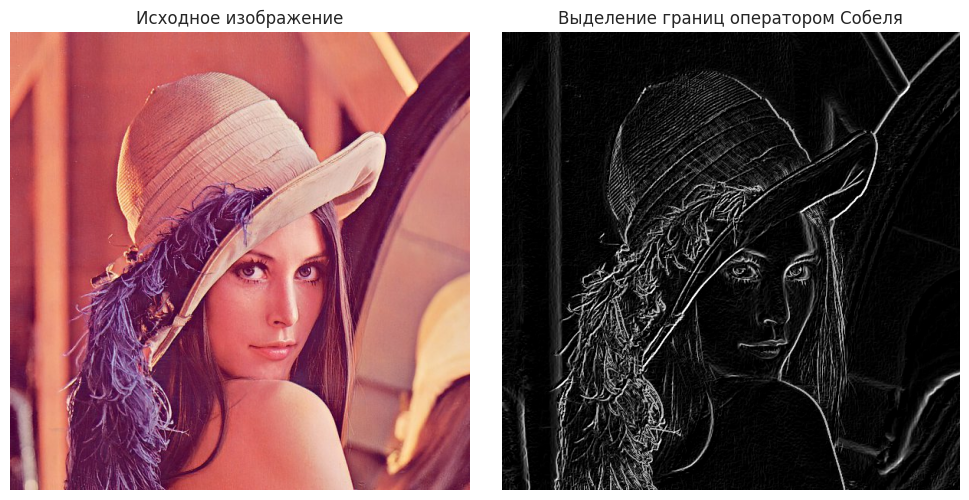

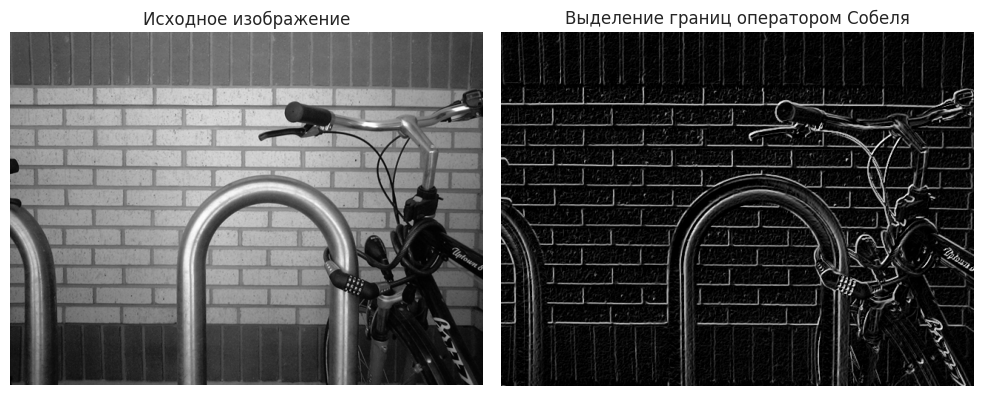

In [ ]:
for i, img in enumerate(imgs):

    img_sobel = np.sqrt(res_images[i][0] ** 2 + res_images[i][1] ** 2)

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 5), sharey=True, sharex=False)

    axs[0].imshow(img, cmap="gray" if i == 1 else None)
    axs[0].set_title("Исходное изображение")
    axs[0].axis("off")

    axs[1].imshow(img_sobel, cmap="gray")
    axs[1].set_title("Выделение границ оператором Собеля")
    axs[1].axis("off")

    plt.tight_layout()

### 2. Pooling

Pooling-слои используются для уменьшения размерности изображения, что позволяет снизить вычислительную сложность и предотвратить переобучение.

**Основные гиперпараметры**

> - **`kernel_size`** (int, tuple): размер ядра, которое применяется к изображению. Определяет область, по которой берётся максимум или среднее значение.
> - **`stride`** (int, tuple): шаг, с которым окно перемещается по изображению. Если не указан, по умолчанию равен `kernel_size`.
> - **`padding`** (int, tuple): количество нулевых пикселей, добавляемых по краям изображения перед применением pooling-операции.

**Основные виды pooling-операций**

1. **`MaxPooling`**  
   Берется максимальное значение из элементов, попавших в область ядра. Это позволяет выделить наиболее значимые признаки на изображении.

2. **`AveragePooling`**  
   Берется среднее значение из элементов, попавших в область ядра. Это помогает сгладить данные и уменьшить влияние шума.

**Интуиция**

Pooling-слои снижают размерность изображения, уменьшая количество параметров и, как следствие, вычислительную сложность модели. Это также помогает модели стать более устойчивой к небольшим изменениям в данных (например, сдвигам или поворотам изображения).

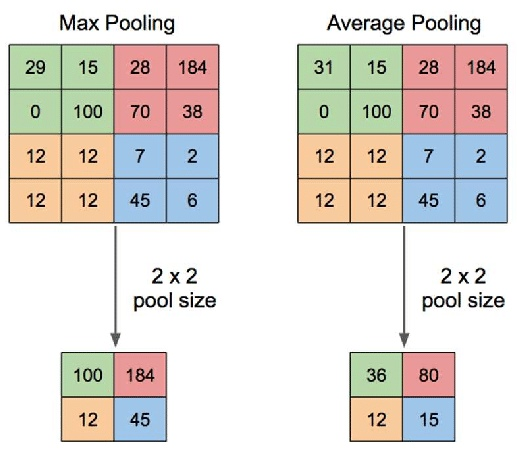

Продемонстрируем работу MaxPooling на нескольких изображениях с разными размерами окон

Напишем функцию для этого:

In [ ]:
def visualize_pooling_multiple_scales(
    image: Union[torch.Tensor, np.ndarray],
    figsize: Tuple[int, int] = (15, 10),
    pooling_type: str = "max",
) -> None:
    """
    Визуализирует работу операции Pooling (MaxPooling или AvgPooling) на изображении с разными размерами окон.

    Параметры:
        image (Union[torch.Tensor, np.ndarray]): Входное изображение в формате (H, W, C) или (C, H, W).
        figsize (Tuple[int, int]): Размер фигуры для визуализации (по умолчанию (15, 10)).
        pooling_type (str): Тип Pooling: "max" для MaxPooling или "avg" для AvgPooling (по умолчанию "max").
    """
    # Проверяем тип изображения и преобразуем его в тензор, если необходимо
    if isinstance(image, np.ndarray):
        image = torch.from_numpy(image).permute(2, 0, 1).to(torch.float32)
    elif isinstance(image, torch.Tensor):
        if image.dim() == 3 and image.shape[0] != 3:  # Если формат (H, W, C), меняем оси
            image = image.permute(2, 0, 1)
    else:
        raise TypeError("Неподдерживаемый тип изображения. Ожидается torch.Tensor или np.ndarray.")

    print(f"Исходное изображение размера: {image.shape}")

    # Размеры окон Pooling, которые хотим визуализировать
    pool_sizes = [2, 4, 8]

    # Словарь для хранения результатов
    pooled_images = {}

    # Создаем фигуру для визуализации с сеткой 1x4
    fig, axes = plt.subplots(1, 4, figsize=figsize)

    # Исходное изображение
    axes[0].imshow(image.permute(1, 2, 0).to(torch.int64))
    axes[0].set_title(f"Исходное изображение ({image.shape[1]}x{image.shape[2]})")
    axes[0].axis("off")

    # Проверяем тип Pooling
    if pooling_type not in ("max", "avg"):
        raise NotImplementedError("pooling_type должен быть 'max' или 'avg'")
    pooling = F.max_pool2d if pooling_type == "max" else F.avg_pool2d
    pooling_name = "MaxPooling" if pooling_type == "max" else "AvgPooling"

    # Применяем Pooling с разными размерами окон и визуализируем результаты
    for i, pool_size in enumerate(pool_sizes):
        # Применяем Pooling
        pooled_image = pooling(image.unsqueeze(0), kernel_size=pool_size, stride=pool_size)[0]
        pooled_images[pool_size] = pooled_image

        print(f"После {pooling_name} {pool_size}x{pool_size} размер: {pooled_image.shape}")

        # Визуализируем результат
        axes[i + 1].imshow(pooled_image.permute(1, 2, 0).to(torch.int64))
        axes[i + 1].set_title(
            f"{pooling_name} {pool_size}x{pool_size} ({pooled_image.shape[1]}x{pooled_image.shape[2]})"
        )
        axes[i + 1].axis("off")

    plt.tight_layout()
    plt.show()

Уменьшим размер изображения для визуализации

MaxPooling
Исходное изображение размера: torch.Size([3, 32, 32])
После MaxPooling 2x2 размер: torch.Size([3, 16, 16])
После MaxPooling 4x4 размер: torch.Size([3, 8, 8])
После MaxPooling 8x8 размер: torch.Size([3, 4, 4])


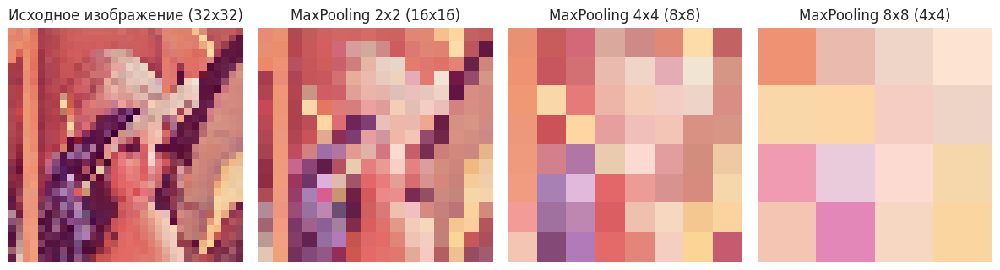

AvgPooling
Исходное изображение размера: torch.Size([3, 32, 32])
После AvgPooling 2x2 размер: torch.Size([3, 16, 16])
После AvgPooling 4x4 размер: torch.Size([3, 8, 8])
После AvgPooling 8x8 размер: torch.Size([3, 4, 4])


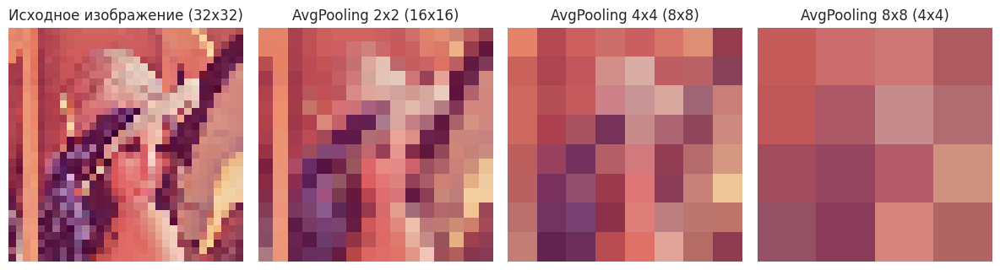

In [ ]:
small_img = cv2.resize(imgs[0], (32, 32))

print("MaxPooling")
visualize_pooling_multiple_scales(small_img, figsize=(12, 6), pooling_type="max")

print("AvgPooling")
visualize_pooling_multiple_scales(small_img, figsize=(12, 6), pooling_type="avg")

### 3. Классификация изображений

####  3.1. Датасет Симпсоны

Рассмотрим датасет "Симпсоны". Он скачивается в ячейке ниже, оригинал лежит по [ссылке](https://www.kaggle.com/alexattia/the-simpsons-characters-dataset/download). Содержит 20 папок (по одной на каждый персонаж) по 400-2000 изображений в каждой папке.

In [5]:
import kagglehub

path = kagglehub.dataset_download("alexattia/the-simpsons-characters-dataset")
print("Path to dataset files:", path)

100%|██████████| 1.08G/1.08G [00:06<00:00, 184MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/alexattia/the-simpsons-characters-dataset/versions/4


В Kaggle можно добавить этот датасет с помощью кнопки `Add Data` на правой панели в области `Data`. Нужно просто в поиске найти "the-simpsons-characters-dataset" и добавить датасет. Он появится в разделе `Input`.

In [6]:
train_dir = os.path.join(path, "simpsons_dataset/simpsons_dataset")

Разделим данные на обучение и валидацию:

In [7]:
class SplitImageFolder:
    """
    Класс для подготовки и разделения датасета изображений на обучающую и валидационную выборки.
    Предполагается структура папок: train_dir/class_name/image.jpg.
    """

    def __init__(self, train_dir: str) -> None:
        """
        Инициализирует объект, сканирует директорию и извлекает метки классов.

        Args:
            train_dir (str): Путь к корневой директории с изображениями для обучения.
        """

        self.train_dir = train_dir

        # Пути до всех файлов в папке train_dir
        self.train_val_files_path = glob.glob(f"{train_dir}/*/*.jpg")

        # Лейблы для всех файлов в папке train_dir
        self.train_val_labels = [path.split("/")[-2] for path in self.train_val_files_path]

    def split(self, test_size: float = 0.3) -> Dict[str, List[str]]:
        """
        Производит стратифицированное разбиение файлов на train и val.

        Args:
            test_size (float): Доля данных, выделяемая под валидацию (от 0.0 до 1.0).

        Returns:
            Dict[str, List[str]]: Словарь с ключами 'train' и 'val', содержащий списки путей к файлам.
        """
        # Разделяем файлы на трейн и валидацию
        train_files_path, val_files_path = train_test_split(
            self.train_val_files_path, test_size=test_size, stratify=self.train_val_labels
        )

        # Сохраняем все трейн и валидацию
        files_path = {"train": train_files_path, "val": val_files_path}

        return files_path


files_path = SplitImageFolder(train_dir).split()

Минимальный размер изображения, с которым работает `ResNet50` &mdash; $200\times200$. В компьютерном зрении часто возникает такая ситуация &mdash; картинки в датасете разного размера и качества. Чаще всего их приводят к одному размеру, например, $256\times256$ или $512\times512$. Приведем все входные изображения к этому размеру с помощью `transforms.Resize`.

In [8]:
input_size = 200

# Трансформация / аугментация для обучающих картинок
train_transform = transforms.Compose(
    [
        # Меняем размер картинки, наименьшая из сторон становится размера input_size
        transforms.Resize(input_size),
        # Вырезаем из центра квадрат размера input_size x input_size
        transforms.CenterCrop(input_size),
        transforms.ColorJitter(0.9, 0.9, 0.9),  # Меняем случайно цвета
        transforms.RandomAffine(5),  # Применяем случайное аффинное преобразование
        transforms.ToTensor(),  # Приводим к тензору
    ]
)

# Трансформация для валидации
val_transform = transforms.Compose(
    [  # Меняем размер картинки, наименьшая из сторон становится размера input_size
        transforms.Resize(input_size),
        # Вырезаем из центра квадрат размера input_size x input_size
        transforms.CenterCrop(input_size),
        transforms.ToTensor(),  # Приводим к тензору
    ]
)

train_dataset = torchvision.datasets.ImageFolder(
    train_dir,
    transform=train_transform,
    is_valid_file=lambda x: x in files_path["train"],
)

val_dataset = torchvision.datasets.ImageFolder(
    train_dir, transform=val_transform, is_valid_file=lambda x: x in files_path["val"]
)

In [9]:
print("Количество классов: ", len(train_dataset.classes))

Количество классов:  42


Визуализируем данные:

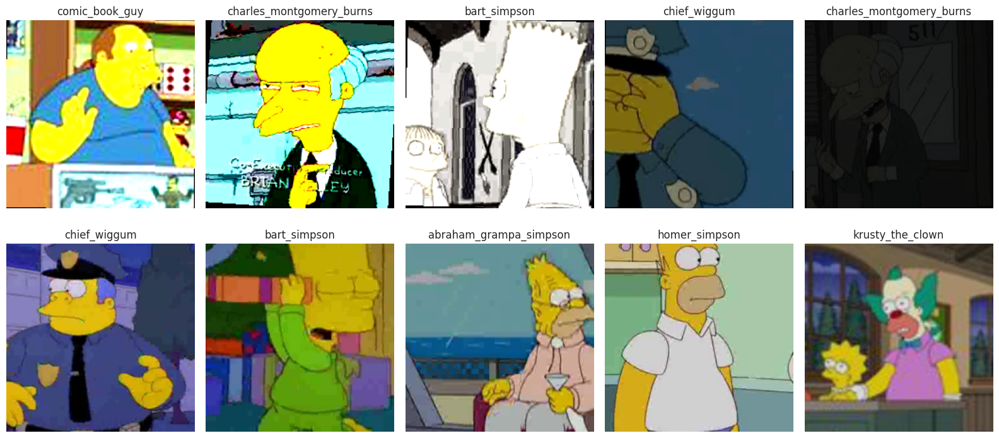

In [10]:
with sns.axes_style("white"):
    fig, axs = plt.subplots(
        nrows=2, ncols=5, figsize=(16, 8), sharey=True, sharex=True, tight_layout=True
    )

    for i, dataset in enumerate([train_dataset, val_dataset]):
        for j in range(5):
            idx = np.random.randint(low=0, high=6000)
            img, label = dataset[idx]
            axs[i, j].set_title(dataset.classes[label])
            axs[i, j].axis("off")
            axs[i, j].imshow(img.numpy().transpose((1, 2, 0)))

#### 3.2. Data Loader / Генератор батчей

В этот раз мы имеем дело с большим количеством данных, и пропускать весь набор через модель за один раз было бы неразумно. Гораздо эффективнее тренировать модель постепенно, разбивая набор на небольшие части (*батчи*). Для этого нам потребуется *генератор батчей*.

В PyTorch предусмотрен универсальный класс [`torch.utils.data.DataLoader`](https://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader), который представляет собой гибкий генератор батчей. Он способен работать с различными типами датасетов, а также поддерживает перемешивание данных при семплировании и многопроцессорность, что делает его очень удобным в использовании.

> **Важные аргументы:**
>
> - **`dataset`** &mdash; объект типа [`torch.utils.data.Dataset`](https://pytorch.org/docs/stable/data.html#torch.utils.data.Dataset) или [`torch.utils.data.IterableDataset`](https://pytorch.org/docs/stable/data.html#torch.utils.data.IterableDataset), из которого будем семплировать.
> - **`batch_size`** (int) &mdash; размер батча.
> - **`shuffle`** (bool) &mdash; перемешивать ли данные.
> - **`num_workers`** (int) &mdash; количество параллельных процессов. Выдаст предупреждение, если указать больше workers, чем допустимо на вашей системе. *Установите значение `-1`, чтобы использовать максимально возможное количество.*
>
> **Использование:**
> ```
> for X_batch, y_batch in dataloader:
>     <...>
> ```
> Здесь `X_batch`, `y_batch` &mdash; объекты размера `batch_size`. Цикл проходит по всему датасету в определенном порядке, пока не закончится объекты в датасете. То есть каждый объект будет возвращен ровно 1 раз.
>
> Важные особенности:
> * Обучающую выборку принято передавать в перемешанном (`shuffle=True`) виде, это увеличивает обобщающую способность модели и уменьшает переобучение.
>
> * Тестовую выборку не перемешивают! Ведь обучение модели уже завершено, и порядок данных не влияет на результат.


Инициализируем `DataLoader` для наших частей датасета

In [11]:
batch_size = 64  # размер батча

train_batch_gen = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_batch_gen = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

#### 3.3. Функции для обучения модели

Стандартный цикл обучения на Pytorch:

``` python
for i in range(num_epochs):
    y_pred = model(x)               # forward pass
    loss = loss_function(y_pred, y) # вычисление лосса
    loss.backward()                 # backward pass
    optimizer.step()                # шаг оптимизации
    optimizer.zero_grad()           # зануляем градиенты
```

Такой цикл мы использовали в <a href="https://thetahat.ru/courses/ad/main/4/nn_simple_examples" target="_top">прошлый раз</a>.

В этот раз мы будем обучать несколько моделей, а также визуализировать историю. Для упрощения процесса все необходимые действия мы поместили в функцию `train`. Она выполняет следующие функции:

1. Записывает лосс и метрики в `history`, а также измеряет время, затраченное на каждую эпоху.
2. На каждой эпохе выполняет два этапа:
   * **Обучение модели**: Полный проход по `train` датасету с подсчетом лосса и точности на каждой итерации.
   * **Валидация модели**: Полный проход по `val` датасету, также с подсчетом лосса и точности на каждой итерации.

> Бывают **слои, поведение которых отличается при обучении и тестировании**, например, dropout. Переключать режим модели можно с помощью `model.train(True)` и `model.train(False)` (эквивалентно `model.eval()`).
>
> Для ускорения работы и предотвращения ошибок в процессе валидации принято использовать `with torch.no_grad()`. Эта обертка говорит Pytorch, что в данный момент не нужно вычислять градиенты, что значительно ускоряет вычисления и снижает вероятность возникновения ошибок.

In [12]:
def plot_histories(histories: List[Dict[str, Dict[str, list]]], names: List[str]) -> None:
    """
    Визуализирует лосс и точность для нескольких моделей на одном графике.

    Параметры:
        histories (List[Dict[str, Dict[str, list]]]): Список историй обучения моделей.
            Каждая история должна содержать ключи "loss" и "acc" с подключами "train" и "val".
        names (List[str]): Список названий моделей для легенды.

    Возвращает:
        None
    """
    # Устанавливаем стиль "darkgrid" только для текущего графика
    with sns.axes_style("darkgrid"):
        # Цвета для графиков
        colors = ["darkblue", "lightcoral", "limegreen", "sandybrown", "darkorange"]

        # Создаем фигуру с двумя подграфиками
        fig, axs = plt.subplots(1, 2, figsize=(14, 5))

        # Определяем количество эпох для отображения (минимальное среди всех историй)
        epochs = np.min([len(h["loss"]["train"]) for h in histories])

        # Построение графиков для каждой модели
        for i, (history, name) in enumerate(zip(histories, names)):
            # График лосса
            axs[0].set_title("Лосс")
            axs[0].plot(
                history["loss"]["train"][:epochs],
                label=f"{name}",
                lw=2,
                c=colors[i],
                ls="--",
            )
            axs[0].plot(
                history["loss"]["val"][:epochs],
                lw=1.5,
                c=colors[i],
            )
            axs[0].set_xlabel("Номер эпохи")

            # График точности
            axs[1].set_title("Точность классификации")
            axs[1].plot(
                history["acc"]["train"][:epochs], label=f"{name}", lw=2, c=colors[i], ls="--"
            )
            axs[1].plot(history["acc"]["val"][:epochs], lw=1.5, c=colors[i])
            axs[1].set_xlabel("Номер эпохи")
            axs[1].legend()

        # Создаем фиктивные линии для легенды (train и val)
        dummy_lines = [
            axs[0].plot([], [], c="black", lw=2, ls="--")[0],
            axs[0].plot([], [], c="black", lw=1.5)[0],
        ]

        # Добавляем легенду для типов линий (train и val)
        for i in range(2):
            legend = axs[i].legend(loc=3 - i)  # Легенда для моделей
            axs[i].legend(dummy_lines, ["train", "val"], loc=4)  # Легенда для типов линий
            axs[i].add_artist(legend)  # Добавляем обе легенды на график

        plt.show()


def print_epoch(
    epoch: int, num_epochs: int, history: Dict[str, Dict[str, List[float]]], t: float
) -> None:
    """
    Выводит информацию о текущей эпохе и обновляет графики обучения.

    Параметры:
        epoch (int): Текущий номер эпохи (начиная с 0).
        num_epochs (int): Общее количество запланированных эпох.
        history (Dict): Словарь с историей метрик (loss, accuracy) по эпохам.
        t (float): Время выполнения эпохи в секундах.
    """
    clear_output(wait=True)
    print("Эпоха {} из {}, затраченное время {:.3f} сек.".format(epoch + 1, num_epochs, t))
    print("  лосс на обучении: \t{:.3f}".format(history["loss"]["train"][-1]))
    print("  лосс на валидации: \t{:.3f}".format(history["loss"]["val"][-1]))
    print("  точность на обучении: \t\t{:.2f} %".format(history["acc"]["train"][-1] * 100))
    print("  точность на валидации: \t\t{:.2f} %".format(history["acc"]["val"][-1] * 100))

    # Строим графики лосса и точности
    plot_histories([history], ["Model"])


def update_history(
    history: Dict[str, Dict[str, list]], loss: float, acc: float, num_batches: int, mode: str
) -> None:
    """
    Обновляет историю обучения, добавляя в нее loss и accuracy для текущей эпохи.

    Параметры:
        history (Dict[str, Dict[str, list]]): Словарь с историей обучения.
        loss (float): Суммарный loss за эпоху.
        acc (float): Суммарная точность за эпоху.
        num_batches (int): Количество батчей в эпохе.
        mode (str): Режим обучения ("train" или "val").
    """
    # Нормализуем loss и accuracy по количеству батчей
    loss /= num_batches
    acc /= num_batches
    history["loss"][mode].append(loss)
    history["acc"][mode].append(acc)


def get_batch_loss(
    X_batch: torch.Tensor,
    y_batch: torch.Tensor,
    model: nn.Module,
    criterion: Callable,
    current_loss: float,
    current_acc: float,
) -> Tuple[torch.Tensor, float, float]:
    """
    Вычисляет loss и accuracy для одного батча (без backward pass).

    Параметры:
        X_batch (torch.Tensor): Батч входных данных.
        y_batch (torch.Tensor): Батч меток.
        model (nn.Module): Модель для обучения (выдает логиты).
        criterion (Callable): Функция потерь.
        current_loss (float): Текущий лосс за батч.
        current_acc (float): Текущая точность за батч.

    Возвращает:
        Tuple[torch.Tensor, float, float]: Лосс на батче, обновленные суммарные loss и accuracy.
    """
    # Перемещаем данные на устройство (GPU/CPU)
    X_batch = X_batch.to(device)
    y_batch = y_batch.to(device)

    # Получаем логиты от модели
    logits = model(X_batch)

    # Вычисляем loss
    loss = criterion(logits, y_batch.long().to(device))

    # Сохраняем лоссы и точность
    current_loss += loss.detach().cpu().numpy()
    y_pred = logits.max(1)[1].detach().cpu().numpy()
    current_acc += np.mean(y_batch.cpu().numpy() == y_pred)
    return loss, current_loss, current_acc


def train(
    model: nn.Module,
    criterion: Callable,
    optimizer: optim.Optimizer,
    train_batch_gen: DataLoader,
    val_batch_gen: DataLoader,
    num_epochs: int = 10,
) -> Dict[str, Dict[str, list]]:
    """
    Обучает модель и возвращает историю обучения.

    Параметры:
        model (nn.Module): Модель для обучения.
        criterion (Callable): Функция потерь.
        optimizer (optim.Optimizer): Оптимизатор.
        train_batch_gen (DataLoader): Генератор батчей для обучения.
        val_batch_gen (DataLoader): Генератор батчей для валидации.
        num_epochs (int): Количество эпох (по умолчанию 40).

    Возвращает:
        Dict[str, Dict[str, list]]: История обучения, содержащая loss и accuracy для обучения и валидации.
    """
    history = defaultdict(lambda: defaultdict(list))

    for epoch in range(num_epochs):
        train_loss, val_loss = 0, 0
        train_acc, val_acc = 0, 0
        start_time = time.time()

        # ----------------------   ОБУЧЕНИЕ   ----------------------#
        model.train(True)

        # На каждой "эпохе" делаем полный проход по данным
        for X_batch, y_batch in tqdm(train_batch_gen, desc="train batch", leave=False):

            # Вычисляем loss и accuracy для батча
            loss, train_loss, train_acc = get_batch_loss(
                X_batch, y_batch, model, criterion, train_loss, train_acc
            )

            # Обратный проход, вычисление градиентов
            loss.backward()
            # Шаг градиентного спуска для обновления оценок весов
            optimizer.step()
            # Зануление градиентов
            optimizer.zero_grad()

        # Обновляем историю обучения
        update_history(history, train_loss, train_acc, len(train_batch_gen), "train")

        # ----------------------   ВАЛИДАЦИЯ   ----------------------#
        model.train(False)

        # Контекстный менеджер, отключающий подсчет градиентов
        with torch.no_grad():
            # Полный проход по валидационному датасету
            for X_batch, y_batch in tqdm(val_batch_gen, desc="val batch", leave=False):
                # Вычисляем loss и accuracy для батча
                _, val_loss, val_acc = get_batch_loss(
                    X_batch, y_batch, model, criterion, val_loss, val_acc
                )

        # Обновляем историю валидации
        update_history(history, val_loss, val_acc, len(val_batch_gen), "val")

        # Выводим информацию о текущей эпохе
        print_epoch(epoch, num_epochs, history, time.time() - start_time)

    return history

#### 3.4. Multi-Layer Perceptron Baseline

Начнем с простой нейросети-MLP из линейных слоев и функций активации, рассмотренной на прошлом занятии по нейросетям:

In [13]:
simple_mlp = nn.Sequential(
    # расплющиваем картинку (C, H, W) в вектор (C * H * W, )
    nn.Flatten(),
    nn.Linear(in_features=3 * 200 * 200, out_features=512),
    # без функции активации модель будет линейной и глупой :(
    nn.ReLU(),
    nn.Linear(in_features=512, out_features=128),
    nn.ReLU(),
    # логиты (logits) для 42 классов
    nn.Linear(in_features=128, out_features=42),
).to(device)

Можно посмотреть количество параметров модели и размерность на промежуточных этапах с помощью `torchinfo.summary(model, input_size)`. Это также удобный инструмент для проверки правильности размерностей, так как их несовпадение может привести к ошибке.

In [14]:
summary(simple_mlp, input_size=(1, 3, 200, 200))

Layer (type:depth-idx)                   Output Shape              Param #
Sequential                               [1, 42]                   --
├─Flatten: 1-1                           [1, 120000]               --
├─Linear: 1-2                            [1, 512]                  61,440,512
├─ReLU: 1-3                              [1, 512]                  --
├─Linear: 1-4                            [1, 128]                  65,664
├─ReLU: 1-5                              [1, 128]                  --
├─Linear: 1-6                            [1, 42]                   5,418
Total params: 61,511,594
Trainable params: 61,511,594
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 61.51
Input size (MB): 0.48
Forward/backward pass size (MB): 0.01
Params size (MB): 246.05
Estimated Total Size (MB): 246.53

Применим ее к нашим данным $-$ картинкам c Симпсонами:

Эпоха 10 из 10, затраченное время 100.918 сек.
  лосс на обучении: 	2.335336
  лосс на валидации: 	2.149137
  точность на обучении: 		37.93 %
  точность на валидации: 		42.03 %


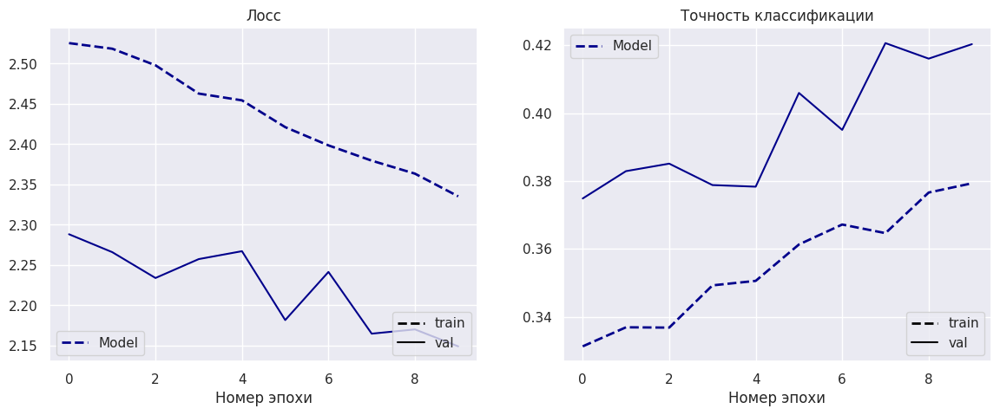

In [ ]:
# Кросс-энтропия - общепринятый лосс для классификации
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(simple_mlp.parameters(), lr=0.01)

history_mlp = train(simple_mlp, criterion, optimizer, train_batch_gen, val_batch_gen, num_epochs=10)
# Сохраняем веса модели в файл, чтобы ее потом можно было подгрузить
torch.save(simple_mlp.state_dict(), "simple_mlp.pth")

**Вывод:**
Как видим, модель MLP правильно предсказывает класс из возможных 10 примерно 50% случаев. Можно ли лучше?

<a name="cnn"></a>
#### 3.5. Свёрточная нейросеть

**Свёрточная нейросеть (CNN)** &mdash; это многослойная нейросеть, имеющая в своей архитектуре свёрточные и pooling-слои.

Простые свёрточные нейросети для классификации почти всегда строятся по следующему правилу:

$$INPUT \longrightarrow \underbrace{\bigg[\big[CONV \to RELU\big]^N \to POOL\:?\bigg]^M}_{\text{Feature extractor}} \longrightarrow \underbrace{\big[FC \to RELU\big]^K}_{\text{Classifier}} \longrightarrow FC,$$
где $CONV$ — сверточные слои, $FC$ — полносвязные слои, а символом "`?`" обозначены опциональные слои.


Поясним схему:
1. Вход &mdash; это batch картинок размера $C \times H \times W$, где $C$ — количество каналов, $H$ — высота изображения, а $W$ — его ширина.

2. **Feature extractor** &mdash; последовательность сверточных и pooling-слоев (convolution + pooling layers). Он предназначен для распознавания сложных паттернов в изображениях и преобразования их в вектор, который содержит всю необходимую информацию о найденных паттернах. Таким образом, мы значительно сокращаем размерность исходного изображения, оставляя только ключевые элементы, важные для классификации.

3. **Classifier** принимает вектор-представление изображения, полученное на выходе из feature extractor-а, и выдает 10 логитов, соответствующих каждому классу. Логиты представляют собой вещественные числа, к которым можно применить `torch.softmax()`, чтобы получить вероятность принадлежности к тому или иному классу.

*Рекомендации:*
  
* Лучше использовать несколько сверток с небольшим ядром, вместо одной свертки с большим ядром. Глубина сети позволяет увеличить сложность распознаваемых паттернов, что в свою очередь повышает качество классификации.

* Pooling &mdash; основной инструмент для уменьшения размерности, что приводит к снижению вычислительной сложности и помогает избежать переобучения модели.

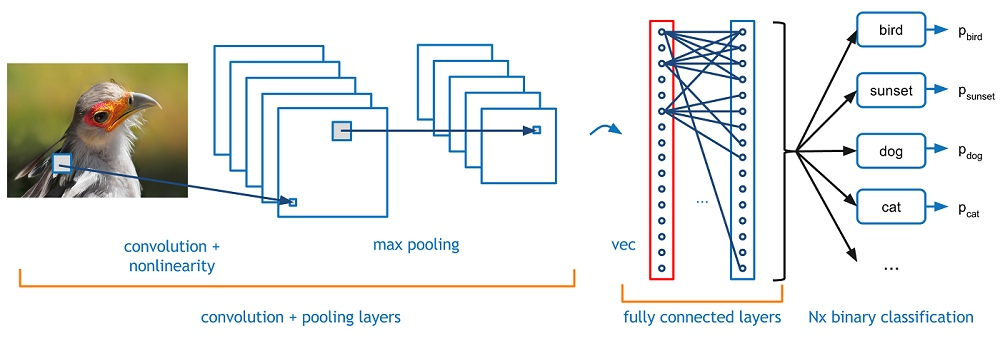

Посмотрим также на реализацию нейросети, состоящую из сверточных слоев и слоев пуллинга.

[`torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0)`](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html)

> **Параметры:**
> - **`in_channels`** (int) — количество каналов во входном изображении.
> - **`out_channels`** (int) — количество каналов после применения свертки (количество фильтров, которые будут применены).
> - **`kernel_size`** (int, tuple) — размер сверточного ядра.
> - **`stride`** (int, tuple) — шаг, с которым будет применена свертка. По умолчанию равен 1.
> - **`padding`** (int, tuple) — добавление по краям изображения дополнительных пикселей. По умолчанию равен 0.


[`nn.MaxPool2d(kernel_size, stride=None)`](https://pytorch.org/docs/stable/generated/torch.nn.MaxPool2d.html)

**Параметры:**
> - **`kernel_size`** (int, tuple) — размер окна, из которого берется максимум.
> - **`stride`** (int, tuple) — шаг, с которым двигается окно. Если не указан, по умолчанию равен `kernel_size`.

---

Подберем архитектуру CNN так, **чтобы количество параметров было примерно таким же, как в MLP** (полносвязная нейросеть). Иначе сравнение было бы нечестным: сеть с б*ó*льшим количеством параметров имела бы преимущество.

In [ ]:
simple_cnn = nn.Sequential(
    # Feature extractor
    nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3),
    nn.MaxPool2d(2),
    nn.ReLU(),
    nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3),
    nn.MaxPool2d(2),
    nn.ReLU(),
    nn.Flatten(),
    # Classifier
    nn.Linear(in_features=147456, out_features=512),
    nn.ReLU(),
    nn.Linear(in_features=512, out_features=42),
).to(device)

Проверим количество параметров. Напомним, для MLP было 61 511 594 параметров.

In [ ]:
summary(simple_cnn, input_size=(1, 3, 200, 200))

Layer (type:depth-idx)                   Output Shape              Param #
Sequential                               [1, 42]                   --
├─Conv2d: 1-1                            [1, 32, 198, 198]         896
├─MaxPool2d: 1-2                         [1, 32, 99, 99]           --
├─ReLU: 1-3                              [1, 32, 99, 99]           --
├─Conv2d: 1-4                            [1, 64, 97, 97]           18,496
├─MaxPool2d: 1-5                         [1, 64, 48, 48]           --
├─ReLU: 1-6                              [1, 64, 48, 48]           --
├─Flatten: 1-7                           [1, 147456]               --
├─Linear: 1-8                            [1, 512]                  75,497,984
├─ReLU: 1-9                              [1, 512]                  --
├─Linear: 1-10                           [1, 42]                   21,546
Total params: 75,538,922
Trainable params: 75,538,922
Non-trainable params: 0
Total mult-adds (Units.MEGABYTES): 284.68
Input size (MB): 0

Обучим CNN:

Эпоха 10 из 10, затраченное время 107.053 сек.
  лосс на обучении: 	2.029104
  лосс на валидации: 	1.982244
  точность на обучении: 		44.43 %
  точность на валидации: 		46.21 %


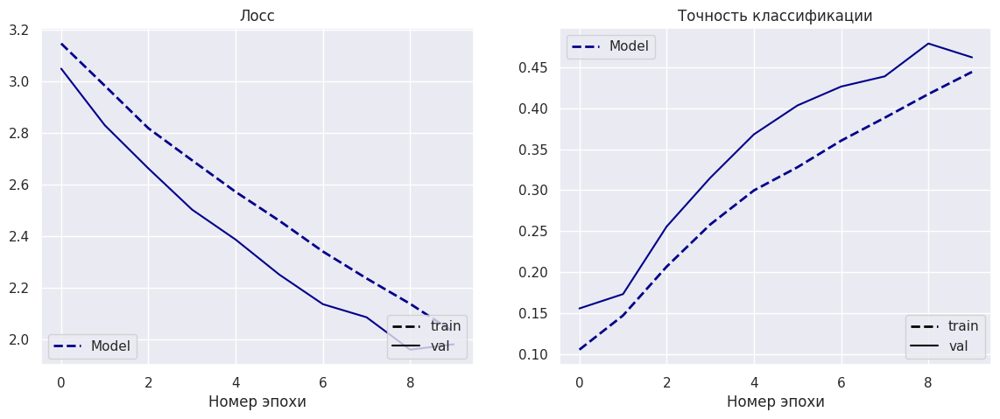

In [ ]:
# Кросс-энтропия - общепринятый лосс для классификации
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(simple_cnn.parameters(), lr=0.01)

history_cnn = train(simple_cnn, criterion, optimizer, train_batch_gen, val_batch_gen, num_epochs=10)
# Сохраняем веса модели в файл, чтобы ее потом можно было подгрузить
torch.save(simple_cnn.state_dict(), "simple_cnn.pth")

Сравним историю обучения обоих сетей

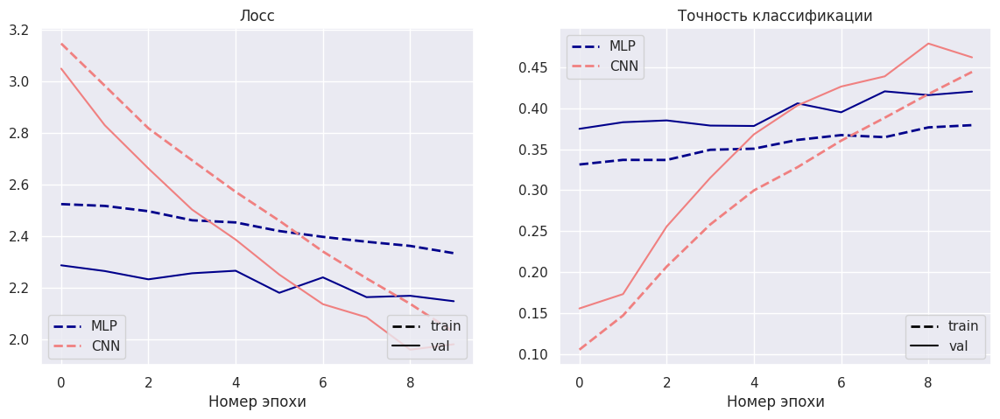

In [ ]:
plot_histories([history_mlp, history_cnn], ["MLP", "CNN"])

**Вывод:**
Мы смогли достичь лучшего качества на тесте, чем MLP.

#### 3.6. Применение VGG для классификации

Для классификации изображений не обязательно всегда самостоятельно писать нейросети. Можно воспользоваться готовыми моделями.

Загрузим необученную VGG16

In [ ]:
vgg16 = models.vgg16(pretrained=False)
vgg16

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

Адаптируем модель для нашей задачи классификации Симпсонов. Для этого мы заменим последний полносвязный слой модели

`Linear(in_features=4096, out_features=1000, bias=True)`

на новый, соответствующий числу классов (42 класса).

In [ ]:
vgg16.classifier[6] = nn.Linear(4096, 42)

Перенесем модель на доступное устройство

In [ ]:
vgg16 = vgg16.to(device)

Необходимо изменить предобработку изображений, так как VGG ожидает изображения большего размера (224x224) и нормированные определенным образом

In [ ]:
transform_for_vgg = transforms.Compose(
    [
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

Создаем новые датасеты с нужной предобработкой

In [ ]:
train_dataset_vgg = torchvision.datasets.ImageFolder(
    train_dir,
    transform=transform_for_vgg,
    is_valid_file=lambda x: x in files_path["train"],
)

val_dataset_vgg = torchvision.datasets.ImageFolder(
    train_dir, transform=transform_for_vgg, is_valid_file=lambda x: x in files_path["val"]
)

Генераторы батчей

In [ ]:
batch_size_vgg = 32  # уменьшаем размер батча из-за увеличения размера изображений

train_batch_gen_vgg = torch.utils.data.DataLoader(
    train_dataset_vgg, batch_size=batch_size_vgg, shuffle=True
)
val_batch_gen_vgg = torch.utils.data.DataLoader(
    val_dataset_vgg, batch_size=batch_size_vgg, shuffle=False
)

Выведем информацию о модели

In [ ]:
summary(vgg16, input_size=(1, 3, 224, 224))

Layer (type:depth-idx)                   Output Shape              Param #
VGG                                      [1, 42]                   --
├─Sequential: 1-1                        [1, 512, 7, 7]            --
│    └─Conv2d: 2-1                       [1, 64, 224, 224]         1,792
│    └─ReLU: 2-2                         [1, 64, 224, 224]         --
│    └─Conv2d: 2-3                       [1, 64, 224, 224]         36,928
│    └─ReLU: 2-4                         [1, 64, 224, 224]         --
│    └─MaxPool2d: 2-5                    [1, 64, 112, 112]         --
│    └─Conv2d: 2-6                       [1, 128, 112, 112]        73,856
│    └─ReLU: 2-7                         [1, 128, 112, 112]        --
│    └─Conv2d: 2-8                       [1, 128, 112, 112]        147,584
│    └─ReLU: 2-9                         [1, 128, 112, 112]        --
│    └─MaxPool2d: 2-10                   [1, 128, 56, 56]          --
│    └─Conv2d: 2-11                      [1, 256, 56, 56]          29

Настраиваем функцию потерь и оптимизатор, обучаем модель

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(
    [p for p in vgg16.parameters() if p.requires_grad], lr=0.001, momentum=0.9
)

Обучаем модель

Эпоха 10 из 10, затраченное время 260.395 сек.
  лосс на обучении: 	0.586651
  лосс на валидации: 	0.895193
  точность на обучении: 		82.73 %
  точность на валидации: 		76.79 %


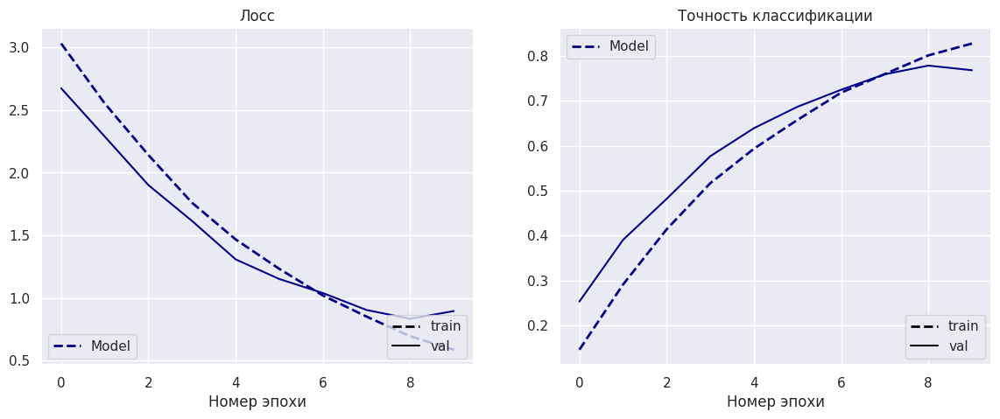

In [ ]:
num_epochs = 10

history_vgg = train(
    vgg16, criterion, optimizer, train_batch_gen_vgg, val_batch_gen_vgg, num_epochs=num_epochs
)

Сохраняем модель в файл

In [ ]:
torch.save(vgg16.state_dict(), "vgg16_simpsons.pth")

Сравниваем результаты

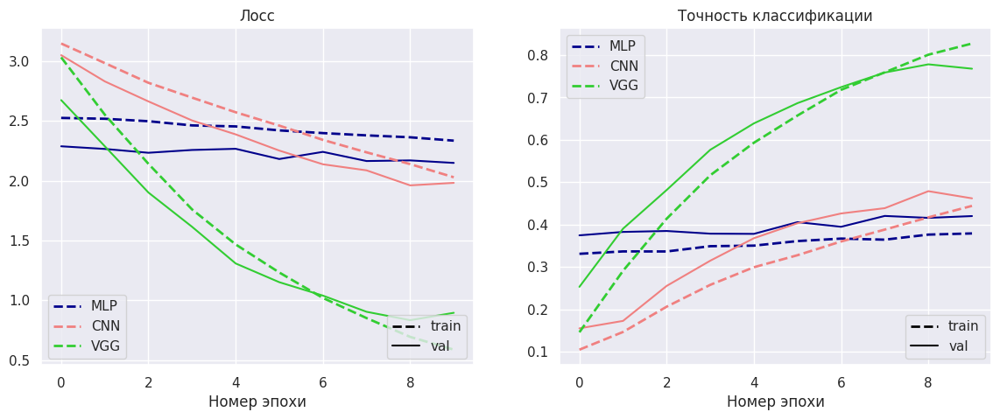

In [ ]:
plot_histories([history_mlp, history_cnn, history_vgg], ["MLP", "CNN", "VGG"])

Вывод:...

Видим, что с первых же итераций VGG оказалась сильно лучше MLP и CNN.
Если мы посмотрим на предыдущие графики, мы сможем увидеть, что результаты наших моделей MLP и CNN даже после 40 итераций не превзошли VGG.

#### 3.7. Применение ResNet для классификации

Загрузим необученную ResNet-18

In [ ]:
resnet50 = models.resnet50(pretrained=False)
resnet50

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

Адаптируем модель для нашей задачи классификации Симпсонов. Для этого мы заменим последний полносвязный слой модели

`Linear(in_features=512, out_features=1000, bias=True)`

на новый, соответствующий числу классов (42 класса).

In [ ]:
resnet50.fc = nn.Linear(2048, 42)

Перенесем модель на доступное устройство

In [ ]:
resnet50 = resnet50.to(device)

Выведем информацию о модели

In [ ]:
summary(resnet50, input_size=(1, 3, 224, 224))

Layer (type:depth-idx)                   Output Shape              Param #
ResNet                                   [1, 42]                   --
├─Conv2d: 1-1                            [1, 64, 112, 112]         9,408
├─BatchNorm2d: 1-2                       [1, 64, 112, 112]         128
├─ReLU: 1-3                              [1, 64, 112, 112]         --
├─MaxPool2d: 1-4                         [1, 64, 56, 56]           --
├─Sequential: 1-5                        [1, 256, 56, 56]          --
│    └─Bottleneck: 2-1                   [1, 256, 56, 56]          --
│    │    └─Conv2d: 3-1                  [1, 64, 56, 56]           4,096
│    │    └─BatchNorm2d: 3-2             [1, 64, 56, 56]           128
│    │    └─ReLU: 3-3                    [1, 64, 56, 56]           --
│    │    └─Conv2d: 3-4                  [1, 64, 56, 56]           36,864
│    │    └─BatchNorm2d: 3-5             [1, 64, 56, 56]           128
│    │    └─ReLU: 3-6                    [1, 64, 56, 56]           --
│ 

Предобработку ResNet требует аналогичную, поэтому не меняем датасет и даталоадеры

Настраиваем функцию потерь и оптимизатор, обучаем модель

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(
    [p for p in resnet50.parameters() if p.requires_grad], lr=0.001, momentum=0.9
)

Обучаем модель (для быстроты на нескольких эпохах)

Эпоха 10 из 10, затраченное время 184.853 сек.
  лосс на обучении: 	0.380742
  лосс на валидации: 	0.680032
  точность на обучении: 		89.70 %
  точность на валидации: 		83.17 %


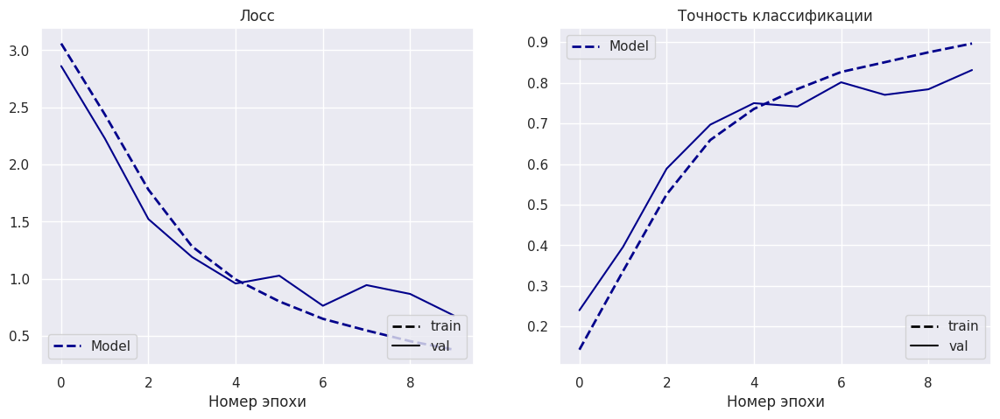

In [ ]:
num_epochs = 10

history_resnet = train(
    resnet50, criterion, optimizer, train_batch_gen_vgg, val_batch_gen_vgg, num_epochs=num_epochs
)

Сохраняем модель в файл

In [ ]:
torch.save(resnet50.state_dict(), "resnet50_simpsons.pth")

Сравниваем результаты

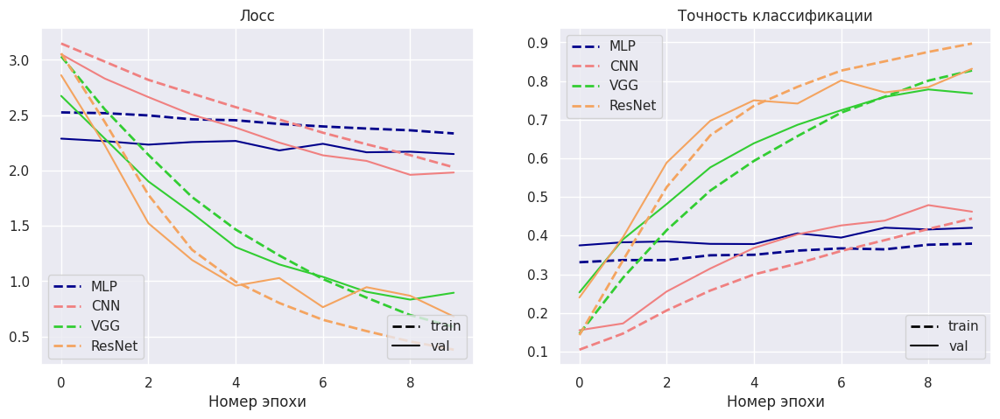

In [ ]:
plot_histories(
    [history_mlp, history_cnn, history_vgg, history_resnet], ["MLP", "CNN", "VGG", "ResNet"]
)

Вывод:

Видим, что с первых же итераций VGG оказалась сильно лучше MLP и CNN.
Если мы посмотрим на предыдущие графики, мы сможем увидеть, что результаты наших моделей MLP и CNN даже после 40 итераций не превзошли VGG.

### 4. Transfer Learning

[Transfer Learning](https://arxiv.org/abs/1808.01974v) &mdash; это процесс дообучения на *новых данных* какой-либо нейросети, предобученной до этого на других данных. Обычно предобучение производят на хорошем, большом  датасете размером около миллиона картинок, например, ImageNet ~ 14 млн картинок.

На данный момент есть множество предобученных моделей: `AlexNet`, `DenseNet`, `ResNet`, `VGG`, `Inception` и другие, а также их различные модификации. Все они отличаются архитектурой и входными данными.

#### 4.1. Описание метода

Что делать, если мы хотим использовать готовую архитектуру сети под свои задачи? Разделяют два подхода.

**1. Fine Tuning / дообучение**  
* Берём сеть, обученную на ImageNet.
* Убираем последние Fully-Connected слои сети, отвечающие за классификацию.
* Замораживаем веса только нескольких первых слоев сети (`param.requires_grad = False`). Последние веса оставляем обучаемыми.
* Добавляем свои слои, если нужно. Например, пару FC-слоёв.
* Обучаем получившуюся архитектуру на новых данных.
   

**2. Feature Extractor / средство для извлечения признаков**
* Берём сеть, обученную на ImageNet.
* Убираем последние Fully-Connected слои сети, отвечающие за классификацию.
* Замораживаем (`param.requires_grad = False`) веса всех предыдущих слоёв.
* Добавляем свои слои если нужно. Например, пару FC-слоёв.
* Обучаем на выходах полученной сети свой классификатор (пару FC-слоёв, например) на новых данных.

Ниже эти подходы изображены на примере VGG архитектуры:

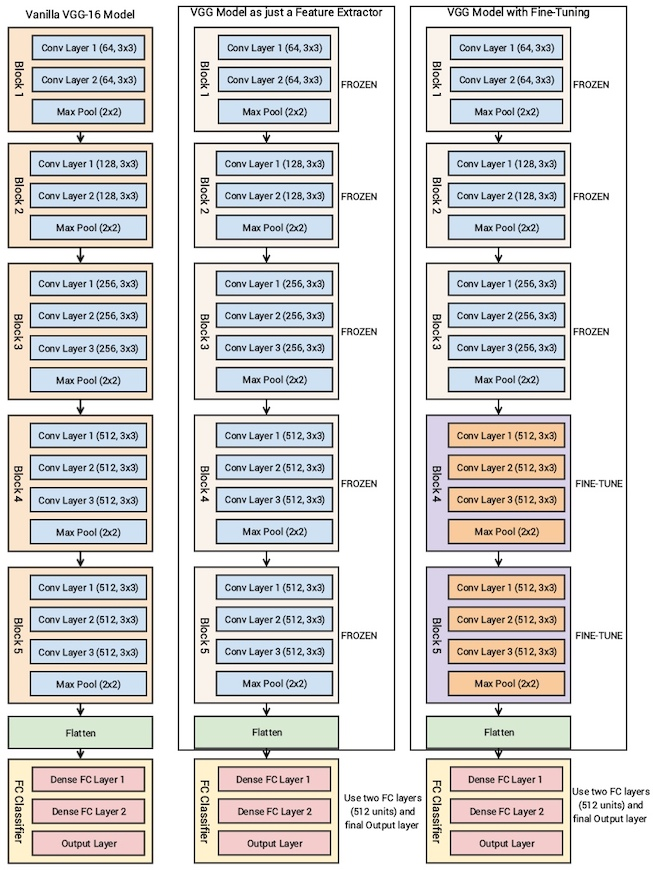

<style>
div.input {

В зависимости от количества и природы Ваших данных есть выбор из **нескольких стратегий Transfer Learning**, а именно:

* *У Вас **мало данных** ($\le 10k$), и они **похожи** на данные, на которых была обучена сеть до этого*  

    * если данные совсем похожи, можно попробовать использовать готовую модель
    * если качество Вас не устраивает, то тогда стоит обратиться к методу Feature Extractor
    * Fine Tuning лучше не использовать. Так как данные похожи на те, на которых обучалась сеть, то высокоуровневые признаки, полученные с помощью последних слоёв сети, должны оказаться информативными. Если делать в этом случае Fine-Tuning, то сеть может переобучиться, поскольку данных мало

* *У Вас **мало данных** ($\le 10k$), и они **не похожи** на данные, на которых была обучена сеть до этого*  
    * в данном случае мы *не можем* ожидать от сети, что выходы последних слоёв будут информативными для новых данных. Следует использовать Feature Extractor, но брать как признаки выходы более ранних слоёв. Ведь, как ожидается, они соответствуют более общим паттернам в данных.
* *У Вас **много данных** ($\ge 10k$), и они **похожи** на данные, на которых была обучена сеть до этого*  
    * можно попробовать использовать готовую модель
    * если качество Вас не устраивает, то тогда стоит cделать Fine-Tuning, ведь данных много, и вероятность переобучения меньше. Имеет смысл попробовать разморохить веса последних нескольких слоёв (можно разморозить и всю сеть)
* *У Вас **много данных** ($\ge 10k$), и они **не похожи** на данные, на которых была обучена сеть до этого*
    * Fine-Tuning практически всей сети. Веса предобученной сети оставляют в качестве инициализации для обучения на новых данных
    
display:none;
}
</style>

В зависимости от нового датасета имеет смысл использовать разные стратегии дообучения:
- если датасет *похож* на тот, на котором модель предобучена, то возможно стоит просто заменить слои классификации;
- если датасет *не похож*, то возможно стоит разморозить и сверточные слои тоже.

**Эмпирическое правило**: *чем больше новый датасет не похож* на тот, на котором обучали модель, *тем больше слоев с конца стоит размораживать*.

Если новый датасет достаточно большой (на каждый класс > 1000 изображений), то можно попробовать разморозить всю нейросеть и обучить со случайных весов, как мы это делали до того, как узнали про Transfer Learning.

#### 4.2. Фреймворки для обучения нейросетей

Мир глубокого обучения давно перешагнул этап, когда нормой считалось ручное написание циклов `for batch in loader: ...`. Точно так же, как вы не пишете ядра CUDA на C++ и не реализуете матричное умножение вручную (доверяя это PyTorch), вам не стоит писать тренировочный цикл с нуля.

Стандартная схема `optimizer.zero_grad()`, `loss.backward()`, `optimizer.step()` — это лишь верхушка айсберга. Попытка построить вокруг этого полноценный пайплайн обучения вручную плоха по нескольким причинам:

- Это долго и рутинно, поскольку 80% кода в таких скриптах — это не логика модели, а инфраструктурный мусор.
- Вы пишете этот код снова и снова в каждом новом проекте.
- Это баговано, поскольку очень легко забыть переключить модель в `model.eval()` при валидации, не перекинуть тензор на GPU, неправильно посчитать метрику или забыть обнулить градиенты.
- Это сложно для внедрения современных техник. Множество вещей вы просто не знаете как написать (и это нормально!)
- Поддерживать простыню кода в тысячи сток просто невозможно. Через полгода ваш самописный `train.py` на 1000 строк превратится в нечитаемое месиво, где логика данных, модели и процесса обучения переплетена так, что изменение одного ломает всё остальное.
- Процесс добавления распределенного обучения для вас станет последней ступенью ада.

Для решения этих проблем существуют высокоуровневые обертки, которые отделяют **науку** (архитектуру модели) от **инженерии** (процесса обучения):

*   **Catalyst** — фокусируется на воспроизводимости экспериментов.
*   **PyTorch Ignite** — дает гибкий контроль над событиями (events) во время обучения.
*   **PyTorch Lightning** — самый популярный на данный момент стандарт, который структурирует код и берет на себя всю "грязную работу".

Далее мы сосредоточимся именно на **PyTorch Lightning**, так как он стал де-факто индустриальным стандартом.


**Установка**

[Installation Guide](https://lightning.ai/docs/pytorch/stable/starter/installation.html)

```bash
# Pip
python -m pip install lightning

# Conda
conda install lightning -c conda-forge
```

**Основные возможности**

Как уже было сказано выше, цель данного фреймворка избавить от необходимости написания лишнего кода.

- **Тренировка и Валидация**

  Lightning автоматизирует переключение между тренировочным и валидационным режимами (а так же test и predict режимы), контролирует циклы обучения, и предоставляет полезные коллбеки. Способ модифицировать цикл обучения/валидации или тестирования добавлением нескольких строк кода, более подробно рассмотрим далее.

- **GPU и TPU**

  Lightning обеспечивает простое управление ресурсами, автоматизируя развертывание модели на доступные устройства (GPUs/TPUs).

- **Масштабирование**

  С легкостью (одной строчкой) можно использовать режимы распределенного обучения (и даже инференса)

- **Модульность и переиспользуемость**:
    - `LightningModule`
    
      Объединяет в себе модель, оптимизатор и логику тренировочного цикла. Может быть использован для предсказаний, а также сохранен и загружен без проблем.

    - `Callbacks`
    
      Позволяют встраивать дополнительную логику в тренировочный цикл без изменения исходного кода модели. А так же есть множество коробчных и сторонних колбеков, отвечающих практически за всю логику, которую вам захочется добавить

- **Разделение логики**:
    - *Research vs Engineering*
    
      Lightning позволяет разработчикам сосредотачиваться на исследовательской части работы, выделяя логику тренировочного цикла и обработку данных в отдельные абстракции.

- **Совместимость и Интеграция**:
    - `LightningModule`
    
      Наследуется от `torch.nn.Module`. Модуль Lightning предоставляет естественный переход от стандартного кода PyTorch, позволяя легко адаптировать существующий код.

    - *Совместимость с библиотеками*
    
      Обширная поддержка различных библиотек и фреймворков для логирования, визуализации и др.

- **Безопасность и Отказоустойчивость**:
    - *Остановка и Возобновление*
    
      Возможность остановки обучения и последующего возобновления с того же места.

    - *Очистка*
    
      Автоматическое освобождение ресурсов GPU после тренировки.

##### 4.2.1. Логирование экспериментов

- Логгер (или их список) передается напрямую в `pl.Trainer`

- В логгер можно писать через `self.log()` внутри Lightning модулей

- Так же в логгер пишут дополнительные коллбеки и плагины, которые вы передаете в `pl.Trainer`

- Некоторые из готовых логгеров:
    - [CSV Logger](https://lightning.ai/docs/pytorch/stable/api/lightning.pytorch.loggers.csv_logs.html#module-lightning.pytorch.loggers.csv_logs)
    - [Mlflow Logger](https://lightning.ai/docs/pytorch/stable/api/lightning.pytorch.loggers.mlflow.html#module-lightning.pytorch.loggers.mlflow)
    - [Tensorboard Logger](https://lightning.ai/docs/pytorch/stable/api/lightning.pytorch.loggers.tensorboard.html#module-lightning.pytorch.loggers.tensorboard)
    - [Wandb Logger (сейчас тяжело пользоваться из России)](https://lightning.ai/docs/pytorch/stable/api/lightning.pytorch.loggers.wandb.html#module-lightning.pytorch.loggers.wandb)

Рассмотрим логирование более подробно на примере фреймворков Tensorboard и MLFlow.

Tensorboard является частью Tensorflow, но выделено в отдельный пакет. Лучше всего подходит для локального логгирования. Он способен:
- Отслеживать и визуализировать метрики, например loss и accuracy.
- Визуализировать вычислительный граф (параметры и слои).
- Просматривать гистограммы весов, сдвигов и то, как они меняются со временем.
- Строить проекции промежуточных представлений в пространства с более низкой размерностью
- Отображать картинки, текст, аудиоданные.

MLFLow &mdash; open source MLOps платформа. Основные возможности:

- Отслеживание экспериментов: код, данные, параметры, результаты
- Проекты: позволяет запаковать data science код для воспроизведения на любой платформе
- Модели: позволяет деплоить модели на сервер
- Model registry: позволяет хранить, описывать и управлять моделями в центральном репозитории

**Установка:**

```bash
# Tensorboard
pip install tensorboard

# MLFlow
pip install mlflow
```

##### 4.2.2. Callbacks

- Коллбеки передаются в `pl.Trainer` и позволяют выполнить какое-то действие в конкретный момент процесса обучения, не изменяя исходный код модели.

- Пользователь может создавать собственные коллбеки, отнаследовавшись от базового `Callback` класса и переписав его методы.

- Некоторые полезные коллбеки, которые встроены в Lightning:

    - `ModelCheckpoint`: автоматически сохраняет чекпоинты модели в процессе обучения

    - `EarlyStopping`: останавливает обучение, когда заданная метрика перестает улучшаться

    - `LearningRateMonitor`: сохраняет значения скорости обучения в логгер

##### 4.2.3. Обучение своей нейросети

In [ ]:
!pip install torchmetrics pytorch-lightning -q

from torchmetrics.functional import accuracy
from pytorch_lightning import LightningModule, Trainer
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks import Callback, ModelCheckpoint

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/983.2 kB ? eta -:--:--
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 983.0/983.2 kB 33.4 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/849.5 kB ? eta -:--:--
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.5/849.5 kB 60.5 MB/s eta 0:00:00


Можно задать свою функцию callback, которая наследуется от `pytorch_lightning.callbacks.Callback`. Бывает полезно после прогона батча на валидации дополнительно сохранять какие-то данные, например, предсказания модели. Здесь мы логируем 20 картинок и предсказания для них.

In [ ]:
class LogPredictionsCallback(Callback):
    def on_validation_batch_end(
        self,
        trainer: Trainer,
        pl_module: LightningModule,
        outputs: torch.Tensor,
        batch: Sequence[torch.Tensor],
        batch_idx: int,
    ) -> None:
        """
        Логирует визуализацию предсказаний и таблицу метрик в TensorBoard после первого батча.

        Параметры:
            trainer (Trainer): Объект тренера, управляющий процессом валидации.
            pl_module (LightningModule): Текущая модель, выполняющая предсказания.
            outputs (torch.Tensor): Тензор с предсказаниями модели из шага validation_step.
            batch (Sequence[torch.Tensor]): Текущий батч данных, содержащий изображения и метки.
            batch_idx (int): Порядковый номер текущего валидационного батча.
        """

        # Логируем только первый батч
        if batch_idx != 0:
            return

        n = 20
        x, y = batch
        preds = outputs

        x = x[:n]  # изображения
        y = y[:n]  # ground truth
        preds = preds[:n]  # предсказания

        tb = trainer.logger.experiment  # TensorBoard SummaryWriter

        # ---- Вариант 1. Логируем картинки ----
        # Преобразуем батч в grid для удобства
        grid = torchvision.utils.make_grid(x, nrow=5, normalize=True, scale_each=True)
        tb.add_image("sample_images", grid, global_step=trainer.global_step)

        # Можно добавить подписи в текстовом виде
        caption_lines = [
            f"{i}: GT={y_i.item()} | Pred={preds[i].item()}" for i, y_i in enumerate(y)
        ]
        text_block = "\n".join(caption_lines)
        tb.add_text("sample_captions", text_block, global_step=trainer.global_step)

        # ---- Вариант 2. Логируем таблицу текстом ----
        table_lines = ["index | ground truth | prediction"]
        for i in range(n):
            table_lines.append(f"{i} | {y[i].item()} | {preds[i].item()}")
        tb.add_text("sample_table", "\n".join(table_lines), global_step=trainer.global_step)


log_predictions_callback = LogPredictionsCallback()

In [ ]:
# callback при достижении лучшей точности создает checkpoint
checkpoint_callback = ModelCheckpoint(monitor="val_accuracy", mode="max")

Инициализируем модель. С помощью `ModelCheckpoint` можно периодически сохранять модель / выполнять callback, отслеживая некоторую величину. Показателем того, что модель стала лучше (параметр `monitor`), может быть любая метрика, сохраненная с помощью `log()` или `log_dict()`.

Создаем Trainer: нужно указать логгер, все функции callback, ускоритель и кол-во эпох.

Осталось обучить модель с помощью `train.fit`. Заметьте, что нам не нужно отдельно прописывать функцию обучения &mdash; Pytorch Lightning сделал это за нас. Также видим статистику по параметрам нашей модели. Бóльшая часть параметров приходится на FC-слой fc3.

Не забывайте сохранять модель, если не делаете этого в ModelCheckpoint.

Когда мы хотим завершить текущий W&B запуск, пишем `wandb.finish()`. Если этого не сделать, WandB продолжит записывать метрики System, такие как температура и использование GPU, пока не будет инициализирован новый запуск (run).

##### 4.1.2. Fine Tuning сети ResNet50

Снова инициализируем даталоадеры, так как они являются генераторами:

In [ ]:
batch_size = 32

training_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validation_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

Зададим backbone модели как предобученный ResNet50, а в конец добавим 2 полносвязных слоя (classifier).

Но сделаем это все новом для нас фреймворке.
*   Наследуем его теперь уже от `pytorch_lightning.LightningModule` &mdash; оболочка над nn.Module из torch-а.
*   Изменим слой `self.fc3`: увеличим входную размерность, и слой `self.fc4`: поставим кол-во классов 42.
*   Методы `training_step`, `validation_step` нужны для логирования метрик.
*   Метод `configure_optimizers` задает оптимизатор, в нашем случае SGD.
*   Приватный метод `__get_preds_loss_accuracy` подсчитывает предсказания, лосс и точность для данного батча.

In [ ]:
class FineTunedResNet(LightningModule):
    """
    PyTorch Lightning модуль для классификации изображений на базе ResNet50.
    Использует предобученный backbone и кастомную голову классификации.
    """

    def __init__(self, n_classes: int = 42, lr: float = 0.01) -> None:
        """
        Инициализирует архитектуру модели и параметры обучения.

        Параметры:
            n_classes (int): Количество классов для классификации.
            lr (float): Скорость обучения (learning rate) для оптимизатора SGD.
        """
        super().__init__()

        self.n_classes = n_classes
        self.criterion = nn.CrossEntropyLoss()
        self.lr = lr
        self.save_hyperparameters()

        backbone = models.resnet50(weights="ResNet50_Weights.DEFAULT")
        num_filters = backbone.fc.in_features
        layers = list(backbone.children())[:-1]
        self.feature_extractor = nn.Sequential(*layers)

        # добавляем 2 FC слоя после выходов предобученной неросети
        self.classifier = nn.Sequential()
        self.classifier.add_module("relu_1", nn.ReLU())
        self.classifier.add_module("fc_1", nn.Linear(num_filters, 512))
        self.classifier.add_module("relu_2", nn.ReLU())
        self.classifier.add_module("fc_2", nn.Linear(512, self.n_classes))

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        Выполняет прямой проход (forward pass) модели.

        Параметры:
            x (torch.Tensor): Входной тензор с изображениями (B, C, H, W).

        Возвращает:
            torch.Tensor: Логиты (сырые предсказания) для каждого класса.
        """
        representations = self.feature_extractor(x).flatten(1)
        out = self.classifier(representations)
        return out

    def training_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        """
        Вычисляет лосс на одном шаге обучения и логирует метрики.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Кортеж, содержащий батч изображений и меток.
            batch_idx (int): Индекс текущего батча.

        Возвращает:
            torch.Tensor: Значение функции потерь.
        """
        _, loss, acc = self.__get_preds_loss_accuracy(batch)

        # Логируем лосс и метрику
        self.log("train_loss", loss)
        self.log("train_accuracy", acc)

        return loss

    def validation_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        """
        Вычисляет метрики на валидации и возвращает предсказания.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Кортеж, содержащий батч изображений и меток.
            batch_idx (int): Индекс текущего батча.

        Возвращает:
            torch.Tensor: Тензор с предсказаниями (индексы классов).
        """
        preds, loss, acc = self.__get_preds_loss_accuracy(batch)

        # Логируем лосс и метрику
        self.log("val_loss", loss)
        self.log("val_accuracy", acc)

        # Возвращаем предсказания, чтобы использовать их в callback
        return preds

    def configure_optimizers(self) -> torch.optim.Optimizer:
        """
        Конфигурирует оптимизатор для обучения.

        Возвращает:
            torch.optim.Optimizer: Оптимизатор SGD с заданным learning rate.
        """
        return torch.optim.SGD(self.parameters(), lr=self.lr)

    def __get_preds_loss_accuracy(
        self, batch: Tuple[torch.Tensor, torch.Tensor]
    ) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        """
        Вспомогательная функция для расчета предсказаний, лосса и точности.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Входные данные (изображения, метки).

        Возвращает:
            Tuple[Tensor, Tensor, Tensor]: Кортеж из (предсказания, лосс, точность).
        """
        x, y = batch
        logits = self(x)
        preds = torch.argmax(logits, dim=1)
        loss = self.criterion(logits, y)
        acc = accuracy(preds, y, "multiclass", num_classes=self.n_classes)
        return preds, loss, acc

Убедимся, что все параметры сети "разморожены", то есть являются обучаемыми:

In [ ]:
finetuned_model = FineTunedResNet()
for param in finetuned_model.feature_extractor.parameters():
    assert param.requires_grad

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 201MB/s]


Зафайнтюним эту модель на наших данных. Делаем новый запуск WandB:

In [ ]:
# callback при достижении лучшей точности создает checkpoint
checkpoint_callback = ModelCheckpoint(monitor="val_accuracy", mode="max")

Для FineTuning достаточно меньше эпох:

In [ ]:
trainer = Trainer(
    logger=TensorBoardLogger(save_dir="logs", name="finetuned"),  # TensorBoard логгер
    callbacks=[
        log_predictions_callback,  # логгер предсказаний
        checkpoint_callback,  # чекпоинтер
    ],
    accelerator="gpu",  # используем GPU
    max_epochs=5,
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores


Здесь на 50М параметров меньше, чем в предыдущей модели, так как размер classifier части намного меньше.

In [ ]:
trainer.fit(finetuned_model, training_loader, validation_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┓
┃   ┃ Name              ┃ Type             ┃ Params ┃ Mode  ┃ FLOPs ┃
┡━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━┩
│ 0 │ criterion         │ CrossEntropyLoss │      0 │ train │     0 │
│ 1 │ feature_extractor │ Sequential       │ 23.5 M │ train │     0 │
│ 2 │ classifier        │ Sequential       │  1.1 M │ train │     0 │
└───┴───────────────────┴──────────────────┴────────┴───────┴───────┘

Trainable params: 24.6 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 24.6 M                                                                                               
Total estimated model params size (MB): 98                                                                         
Modules in train mode: 156                                                                                         
Modules in eval mode: 0                                                                                            
Total FLOPs: 0

Output()

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

Видим хорошую `val_accuracy`.

In [ ]:
torch.save(finetuned_model.state_dict(), "finetuned_model.pth")

##### 4.1.3. Feature Extractor сети ResNet50

Заменяем последний слой классификатора на линейный классификатор, заморозим все остальные слои:

In [ ]:
class FrozenFeatExtrResNet(LightningModule):
    """
    Модель классификации на базе ResNet50 с замороженным backbone (feature extractor).
    Обучаются только веса финального классификационного слоя.
    """

    def __init__(self, n_classes: int = 42, lr: float = 0.01) -> None:
        """
        Инициализирует модель, загружает веса и замораживает слои извлечения признаков.

        Параметры:
            n_classes (int): Количество классов для классификации.
            lr (float): Скорость обучения (learning rate).
        """
        super().__init__()

        self.n_classes = n_classes
        self.criterion = nn.CrossEntropyLoss()
        self.lr = lr
        self.save_hyperparameters()

        backbone = models.resnet50(weights="ResNet50_Weights.DEFAULT")
        num_filters = backbone.fc.in_features
        layers = list(backbone.children())[:-1]
        self.feature_extractor = nn.Sequential(*layers)

        # "замораживаем" все веса всех слоев
        for param in self.feature_extractor.parameters():
            param.requires_grad = False
        # этот слой будет обучаемым
        self.classifier = nn.Linear(num_filters, self.n_classes)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        Выполняет прямой проход с извлечением признаков в режиме eval.

        Параметры:
            x (torch.Tensor): Входной тензор изображений.

        Возвращает:
            torch.Tensor: Логиты предсказаний модели.
        """
        self.feature_extractor.eval()
        with torch.no_grad():
            representations = self.feature_extractor(x).flatten(1)
        out = self.classifier(representations)
        return out

    def training_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        """
        Вычисляет лосс на обучающем батче.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Батч данных (изображения, метки).
            batch_idx (int): Индекс текущего батча.

        Возвращает:
            torch.Tensor: Значение функции потерь.
        """
        _, loss, acc = self.__get_preds_loss_accuracy(batch)

        # Логируем лосс и метрику
        self.log("train_loss", loss)
        self.log("train_accuracy", acc)

        return loss

    def validation_step(
        self, batch: Tuple[torch.Tensor, torch.Tensor], batch_idx: int
    ) -> torch.Tensor:
        """
        Вычисляет метрики на валидационном батче.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Батч данных (изображения, метки).
            batch_idx (int): Индекс текущего батча.

        Возвращает:
            torch.Tensor: Предсказанные классы.
        """
        preds, loss, acc = self.__get_preds_loss_accuracy(batch)

        # Логируем лосс и метрику
        self.log("val_loss", loss)
        self.log("val_accuracy", acc)

        # Возвращаем предсказания, чтобы использовать их в callback
        return preds

    def configure_optimizers(self) -> torch.optim.Optimizer:
        """
        Создает оптимизатор для обучаемых параметров модели.

        Возвращает:
            torch.optim.Optimizer: Оптимизатор SGD.
        """
        return torch.optim.SGD(self.parameters(), lr=self.lr)

    def __get_preds_loss_accuracy(
        self, batch: Tuple[torch.Tensor, torch.Tensor]
    ) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        """
        Вспомогательный метод для расчета предсказаний и метрик.

        Параметры:
            batch (Tuple[Tensor, Tensor]): Батч данных.

        Возвращает:
            Tuple[Tensor, Tensor, Tensor]: Кортеж (предсказания, лосс, точность).
        """
        x, y = batch
        logits = self(x)
        preds = torch.argmax(logits, dim=1)
        loss = self.criterion(logits, y)
        acc = accuracy(preds, y, "multiclass", num_classes=self.n_classes)
        return preds, loss, acc

Создаем новый запуск WandB:

In [ ]:
featextr_model = FrozenFeatExtrResNet()

# callback при достижении лучшей точности создает checkpoint
checkpoint_callback = ModelCheckpoint(monitor="val_accuracy", mode="max")

In [ ]:
trainer = Trainer(
    logger=TensorBoardLogger(save_dir="logs", name="frozenextr"),  # логгер из WandB
    callbacks=[
        log_predictions_callback,  # логгер предсказаний
        checkpoint_callback,  # чекпоинтер
    ],
    accelerator="gpu",  # используем GPU
    max_epochs=5,
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores


Видим, что *Non-trainable params = 23.5M* - feature extractor дейcтвительно заморожен. На самом деле, обучается всего 86.1K параметров.

In [ ]:
trainer.fit(featextr_model, training_loader, validation_loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┓
┃   ┃ Name              ┃ Type             ┃ Params ┃ Mode  ┃ FLOPs ┃
┡━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━┩
│ 0 │ criterion         │ CrossEntropyLoss │      0 │ train │     0 │
│ 1 │ feature_extractor │ Sequential       │ 23.5 M │ train │     0 │
│ 2 │ classifier        │ Linear           │ 86.1 K │ train │     0 │
└───┴───────────────────┴──────────────────┴────────┴───────┴───────┘

Trainable params: 86.1 K                                                                                           
Non-trainable params: 23.5 M                                                                                       
Total params: 23.6 M                                                                                               
Total estimated model params size (MB): 94                                                                         
Modules in train mode: 152                                                                                         
Modules in eval mode: 0                                                                                            
Total FLOPs: 0

Output()

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.


In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 59242), started 0:15:55 ago. (Use '!kill 59242' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
torch.save(featextr_model.state_dict(), "featextr_model.pth")

### 5. Интерпретация

#### 5.1. Каким фильтрам научилась свертка?


Зафиксируем 5 картинок, на которых будем визуализировать свертки.

In [62]:
for X_batch, y_batch in train_batch_gen:
    break
idx = np.array([26, 11, 1, 31, 23])
imgs = [X_batch[i].numpy().transpose(1, 2, 0) for i in idx]

Следующая функция достает 5 случайных ядер из модели с 1-ого сверточного слоя применяет к 5 выбранным картинкам.

In [63]:
def visualize_trained_kernels(model: nn.Module) -> None:
    """
    Визуализирует случайные фильтры первого слоя и результат их свертки с изображениями.

    Параметры:
        model (nn.Module): Обученная модель, содержащая слой conv1.
    """
    weights = model.conv1.weight
    rand_idx = np.random.choice(np.arange(32), 5)
    kernels = [weights[i, 0].detach() for i in rand_idx]
    res = [
        [
            convolution(
                kernels[j].unsqueeze(0).unsqueeze(0),
                imgs[i],
                transforms.ToTensor(),
                kernel_size=len(kernels[0]),
            )
            for j in range(5)
        ]
        for i in range(5)
    ]

    fig, axs = plt.subplots(6, 6, figsize=(20, 20))
    axs[0, 0].set_visible(False)
    for j in range(5):
        axs[0, j + 1].axis("off")
        axs[0, j + 1].imshow(kernels[j].numpy(), cmap="gray")
    for i in range(5):
        axs[i + 1, 0].axis("off")
        axs[i + 1, 0].imshow(imgs[i])

    for i in range(5):
        for j in range(5):
            normalized = res[i][j] * (255 // res[i][j].max())
            axs[i + 1, j + 1].imshow(normalized.permute(1, 2, 0))
            axs[i + 1, j + 1].axis("off")

    plt.tight_layout()

Посмотрим на свертки у модели, где ядра были размера $7\times 7$. Здесь результат применения свертки &mdash; то, что модель получает на вход второго сверточного слоя.

In [64]:
model = models.resnet50(weights="ResNet50_Weights.DEFAULT")

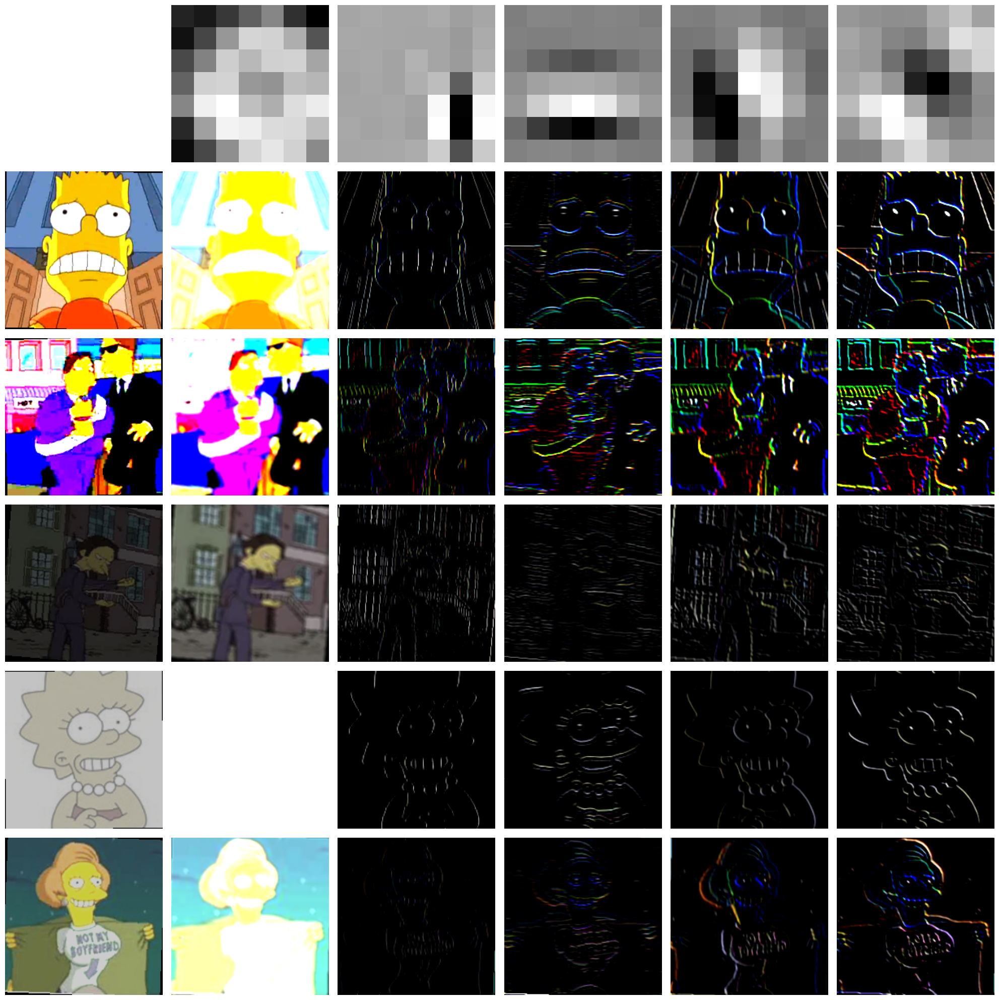

In [65]:
visualize_trained_kernels(model)

Видим, что разные фильтры обучились распознавать разные паттерны.

#### 5.2. Lucid / Lucent

[Lucid](https://github.com/tensorflow/lucid) &mdash; это библиотека для исследования интерпретируемости нейронных сетей на TensorFlow. У нее есть аналог для PyTorch - [Lucent](https://github.com/greentfrapp/lucent).


In [67]:
!pip install --quiet git+https://github.com/greentfrapp/lucent.git
from lucent.optvis import render

  Preparing metadata (setup.py) ... done


<img src="https://raw.githubusercontent.com/greentfrapp/lucent/master/images/lucent_header.jpg" width="600"></img>

Выше мы обучили сверточную сеть с 2 слоями свертки. Теперь с помощью библиотеки мы визуализируем признаки, которые выучила модель, с помощью оптимизации. Как это работает?

Нейронные сети дифференцируемы по входным данным. Хотим выяснить, какой тип входных данных больше активирует определенный нейрон модели. Значит, мы можем использовать производные для итеративного изменения входной картинки, при этом инициализация в начале - просто шум. Посмотрим на результаты для 8 случайных нейронов со 2 слоя.

Обработка layer1 (выбранные каналы: [229  38 148  17  25   0])...


100%|██████████| 512/512 [03:00<00:00,  2.84it/s]


Обработка layer2 (выбранные каналы: [ 13 350 439 274  51 115])...


100%|██████████| 512/512 [03:46<00:00,  2.26it/s]


Обработка layer3 (выбранные каналы: [   3 1000  721  532  421  327])...


100%|██████████| 512/512 [05:40<00:00,  1.50it/s]


Обработка layer4 (выбранные каналы: [1086  101  183  971 1320 1852])...


100%|██████████| 512/512 [06:08<00:00,  1.39it/s]


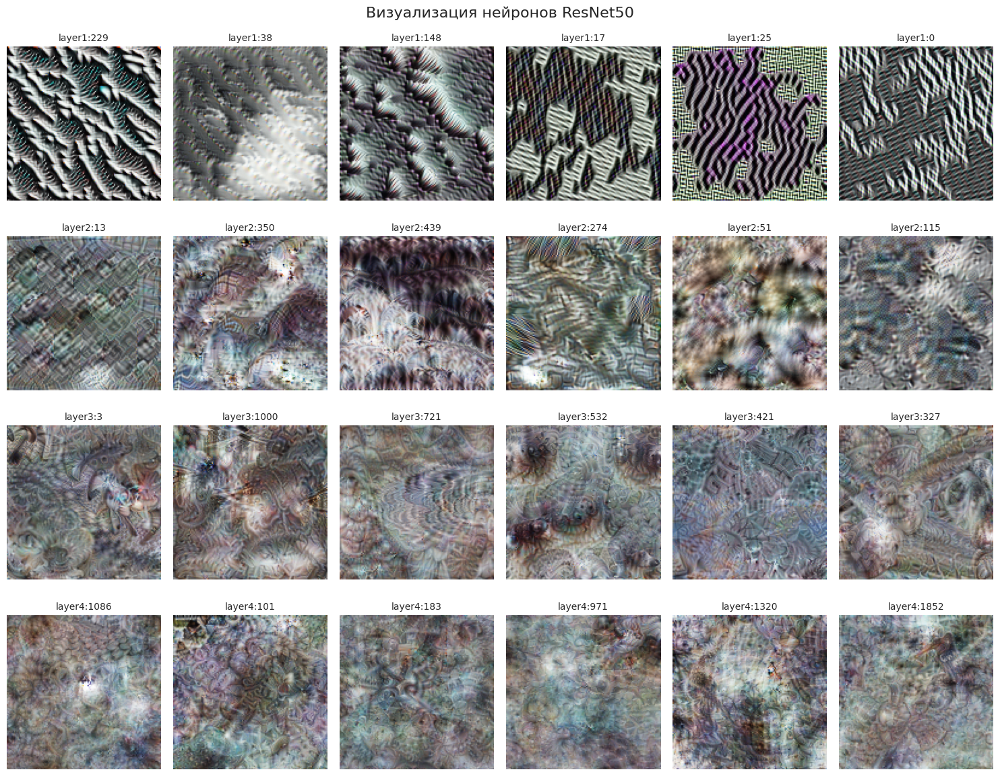

In [68]:
# Конфигурация слоев ResNet50
layers_config = {"layer1": 256, "layer2": 512, "layer3": 1024, "layer4": 2048}

images_per_layer = 6  # Количество нейронов для визуализации для каждого слоя
total_layers = len(layers_config)

fig, axs = plt.subplots(total_layers, images_per_layer, figsize=(15, 12))
fig.suptitle(f"Визуализация нейронов ResNet50", fontsize=16)

for row_idx, (layer_name, num_channels) in enumerate(layers_config.items()):

    # Выбираем случайные индексы каналов для текущего слоя
    rand_indices = np.random.choice(np.arange(num_channels), images_per_layer, replace=False)

    print(f"Обработка {layer_name} (выбранные каналы: {rand_indices})...")

    for col_idx, channel_idx in enumerate(rand_indices):
        target_neuron = f"{layer_name}:{channel_idx}"

        # Получаем изображение
        # show_image=False, чтобы не выводить промежуточные картинки
        images = render.render_vis(
            model, target_neuron, thresholds=(512,), show_image=False, progress=True
        )
        img = images[0][0]

        ax = axs[row_idx, col_idx]
        ax.imshow(img)
        ax.set_title(f"{target_neuron}", fontsize=10)
        ax.axis("off")

plt.tight_layout()
plt.show()

---
© 2025 команда <a href="https://thetahat.ru/">ThetaHat</a> для курса ML-1 ШАД